# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.00005
scheduler_gamma = [0.5, 0.5, 0.7, 0.6]
scheduler_milestones = [500, 700, 1000, 1300]

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


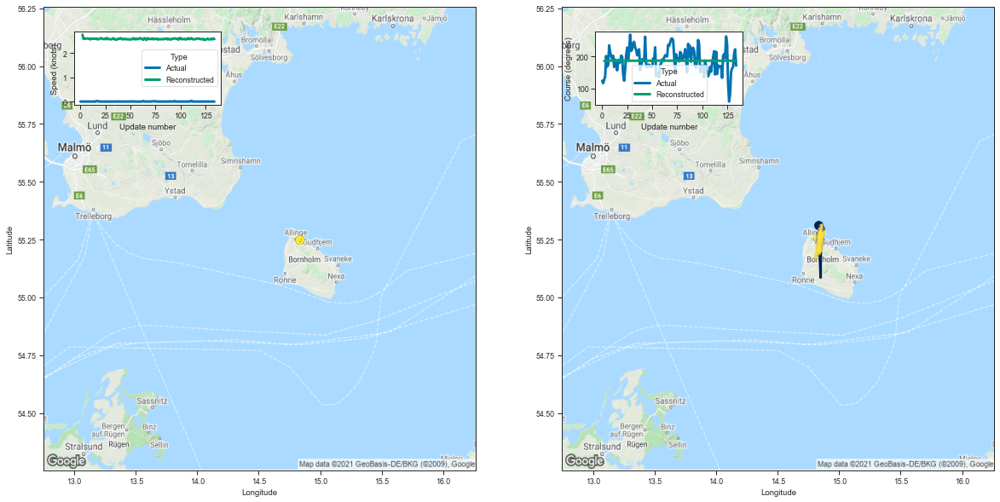

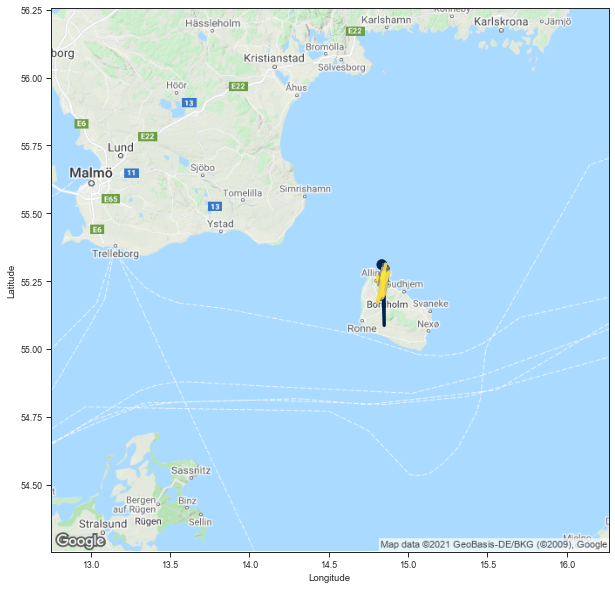

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  1943886  230069190  14.835619  55.247898  0.000000   
1                 0  1943886  230069190  14.835618  55.247887  0.001724   
2                 0  1943886  230069190  14.835608  55.247883  0.001639   
3                 0  1943886  230069190  14.835607  55.247887  0.001639   
4                 0  1943886  230069190  14.835599  55.247902  0.001639   
..              ...      ...        ...        ...        ...       ...   
130               0  1943886  230069190  14.835618  55.247906  0.000000   
131               0  1943886  230069190  14.835605  55.247902  0.000000   
132               0  1943886  230069190  14.835608  55.247898  0.001887   
133               0  1943886  230069190  14.835602  55.247894  0.000000   
134               0  1943886  230069190  14.835607  55.247894  0.000000   

         Course Ship type  Track length          Time stamp  
0    124.631668   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.834978,55.310467,2.752156,186.348953,0.024371,0.072383,3.309734,99.928734
3,14.849663,55.086670,2.585620,186.546188,0.017518,0.047520,3.213067,100.045990
4,14.851213,55.255966,2.575268,187.211594,0.016702,0.045608,3.202333,100.406206
5,14.844874,55.242943,2.593340,187.129959,0.016926,0.045431,3.214128,100.375418
6,14.857759,55.290485,2.589931,187.349304,0.016531,0.044476,3.216849,100.494500
...,...,...,...,...,...,...,...,...
130,14.841265,55.196640,2.564125,187.064423,0.016372,0.044548,3.190795,100.345108
131,14.841403,55.279816,2.583735,187.288162,0.016699,0.044574,3.214343,100.453547
132,14.846499,55.261017,2.552941,187.304993,0.016003,0.043465,3.188778,100.476020
133,14.851041,55.283569,2.596751,187.309036,0.016785,0.045160,3.221859,100.468653


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


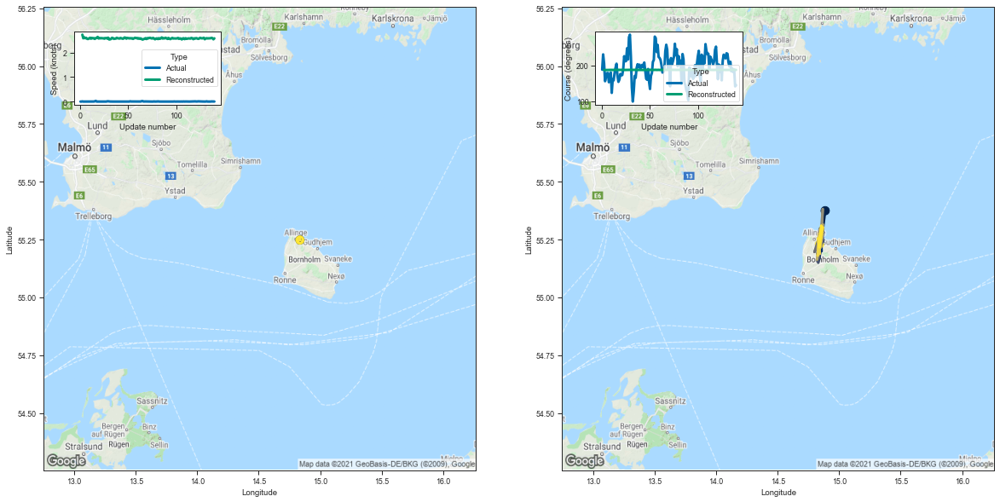

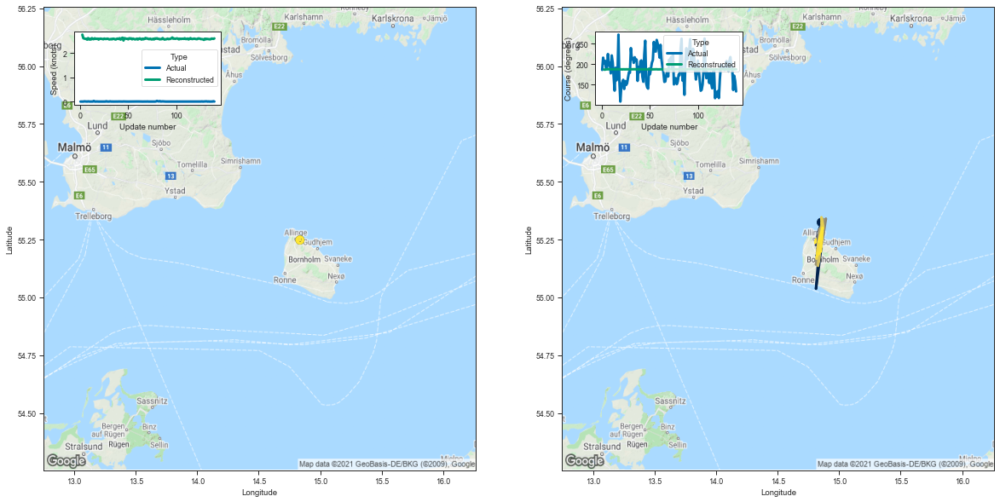

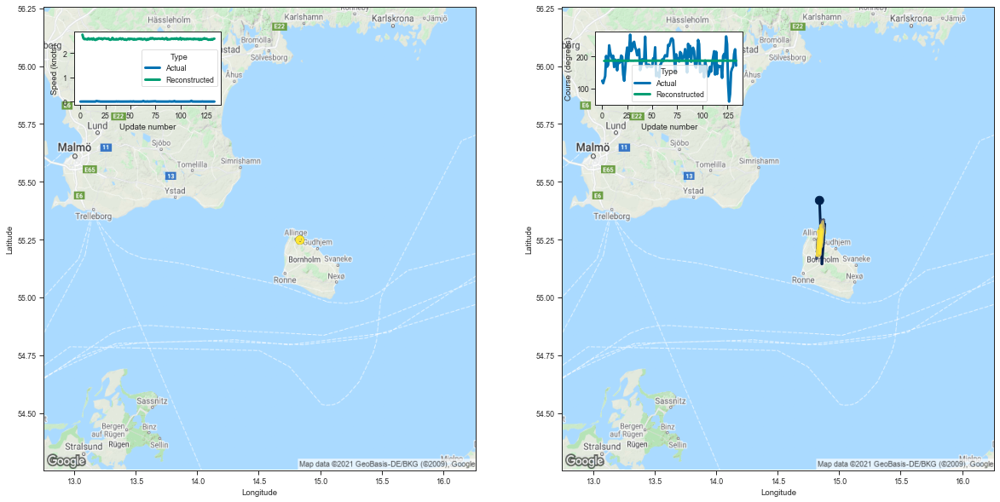

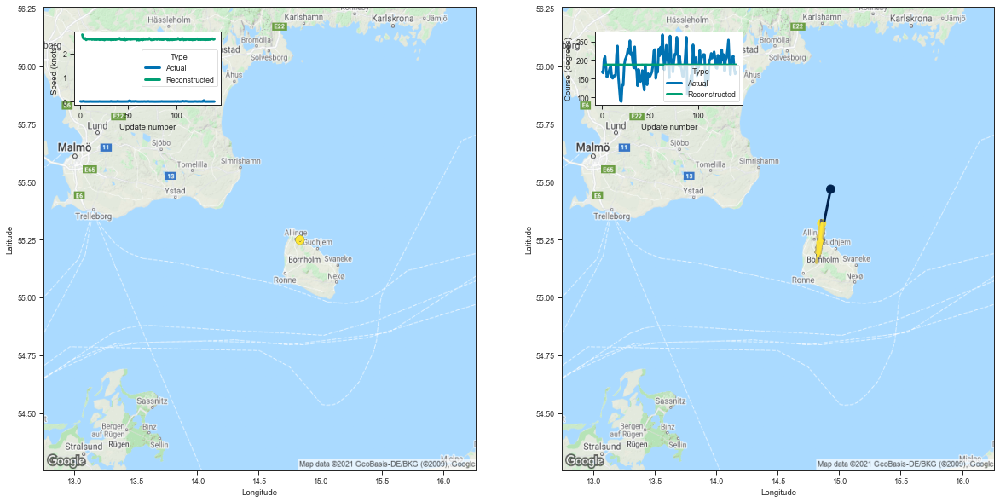

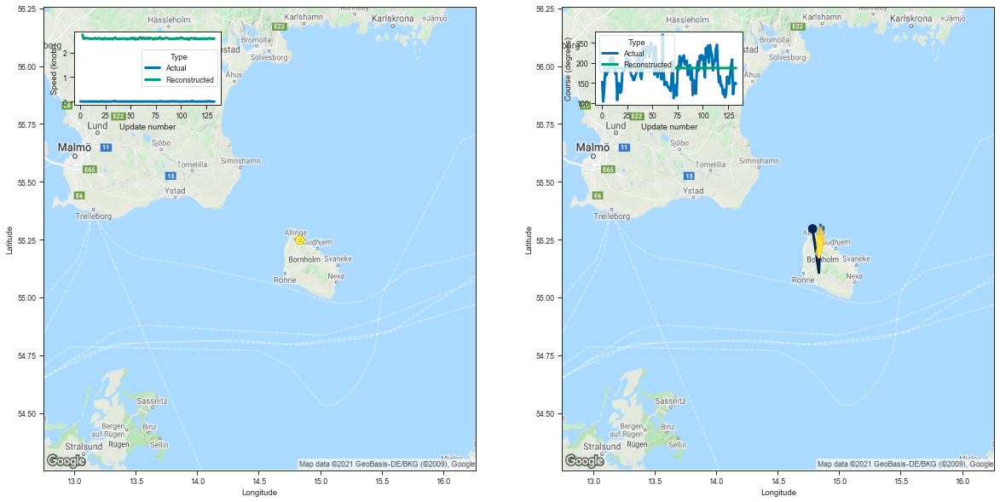

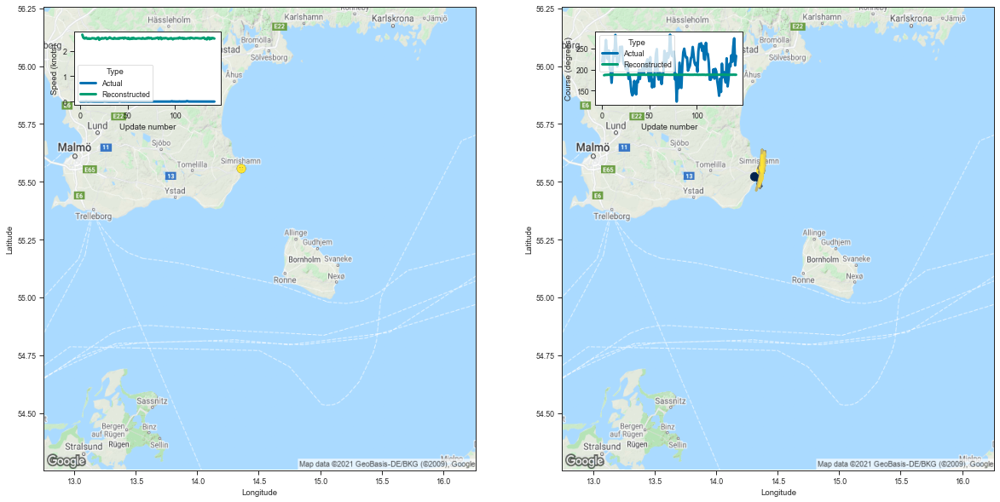

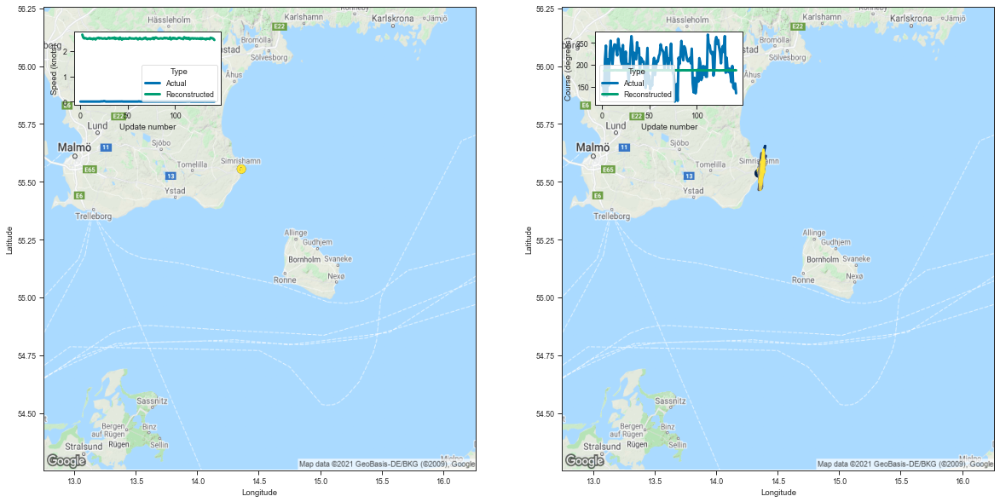

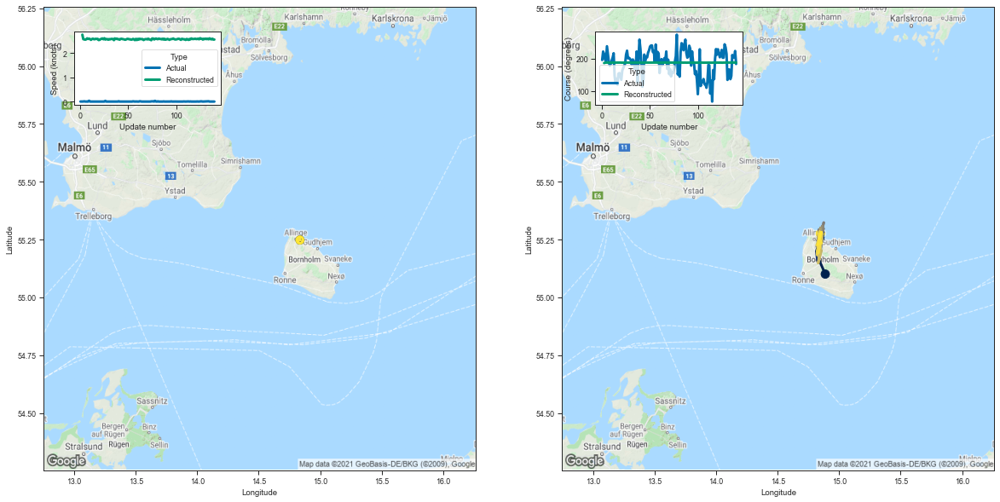

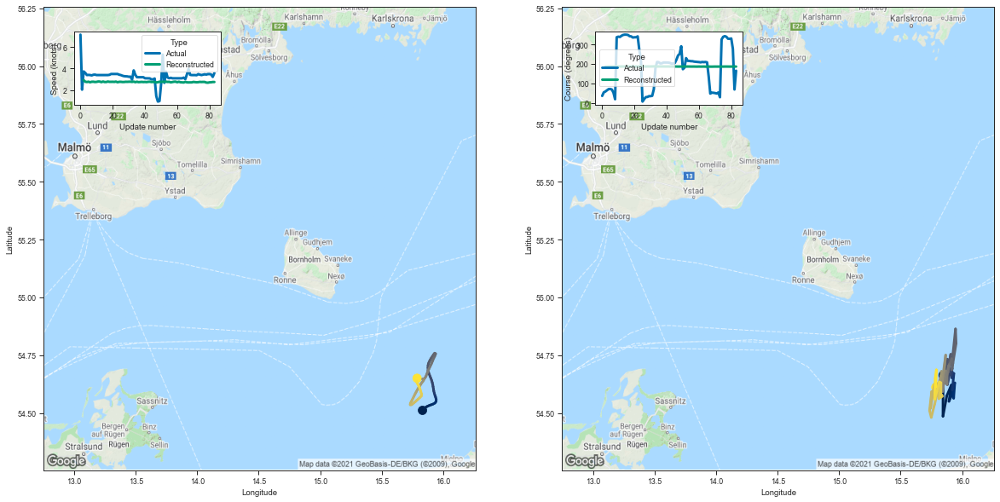

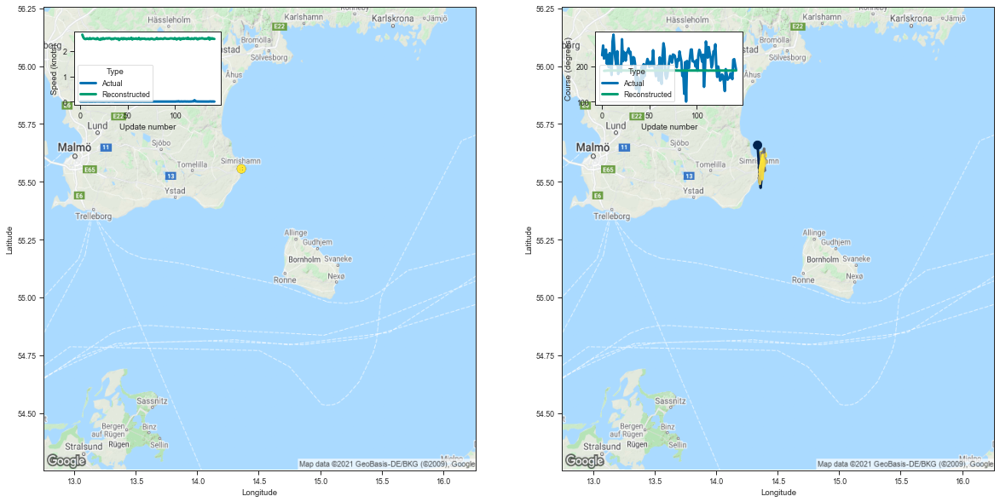

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
102,102,2204657,230069190,Fishing,141,-495.506348,-3.514229
4,4,2259131,230069190,Fishing,141,-497.148102,-3.525873
8,8,1943886,230069190,Fishing,135,-479.868774,-3.554584
98,98,2159262,230069190,Fishing,141,-503.241943,-3.569092
20,20,1961288,230069190,Fishing,134,-481.177124,-3.590874
17,17,6685896,265759000,Fishing,143,-514.892395,-3.600646
74,74,6962046,265759000,Fishing,143,-525.814026,-3.677021
70,70,2240973,230069190,Fishing,141,-518.625244,-3.678193
27,27,3500868,261003230,Fishing,84,-310.692078,-3.698715
95,95,6805561,265759000,Fishing,143,-533.216797,-3.728789


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


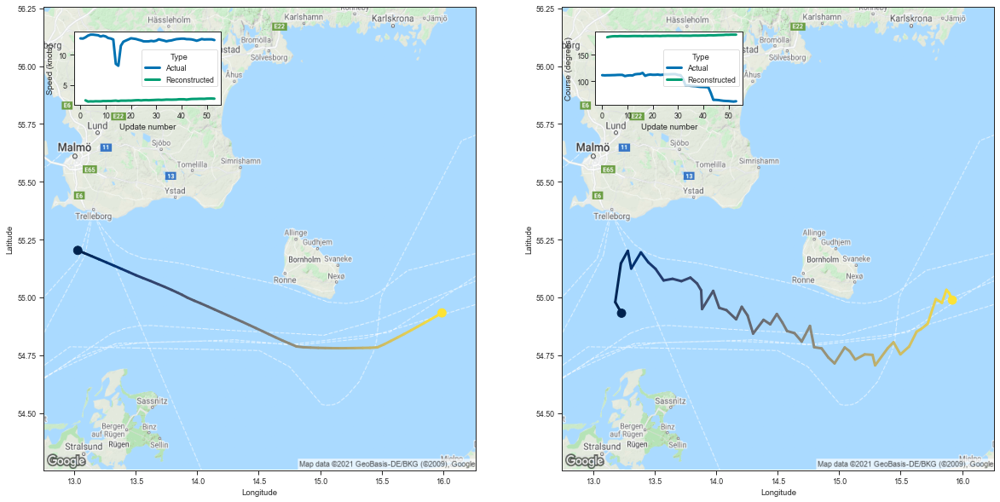

[2.4869940280914307, 2.2827155590057373, 2.318920373916626, 2.30208420753479]


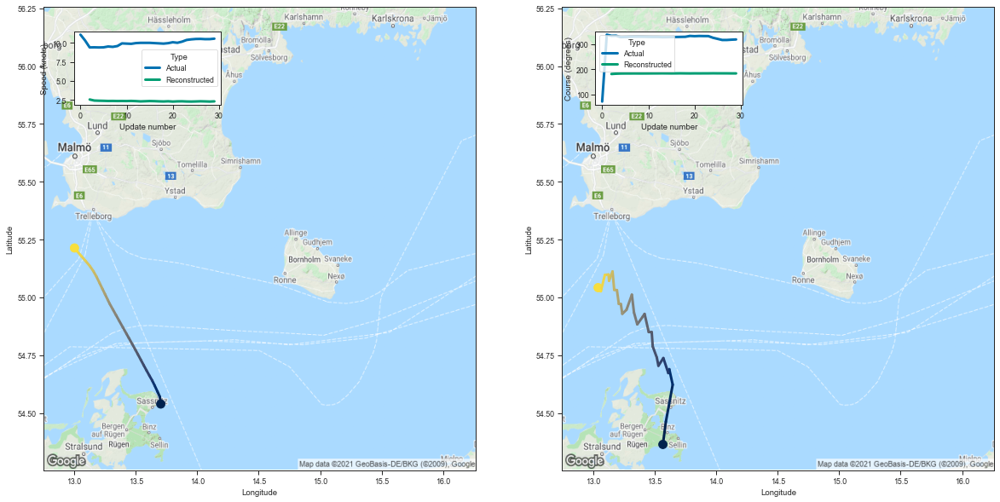

[2.5464975833892822, 2.407564401626587, 2.3855764865875244, 2.3719942569732666]


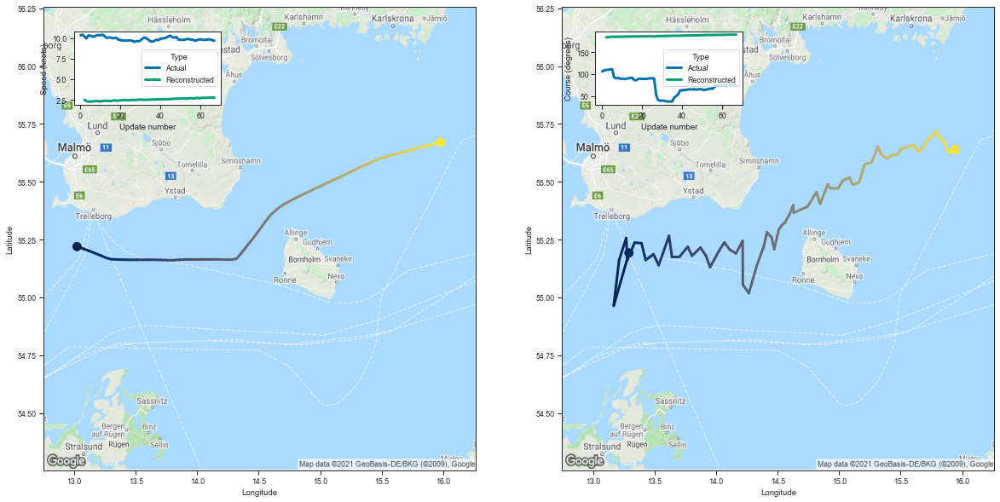

[2.5072181224823, 2.334806203842163, 2.2881057262420654, 2.2944276332855225]


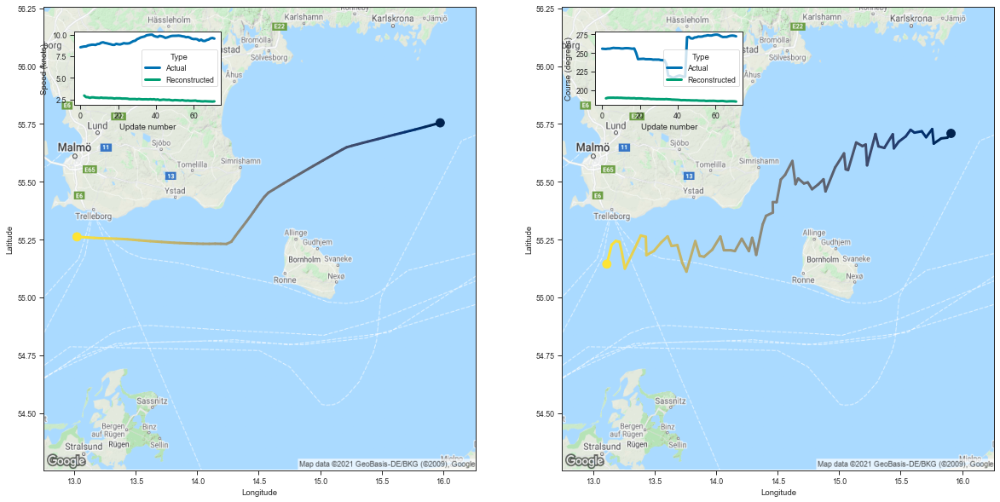

[2.9652764797210693, 2.783363103866577, 2.7736685276031494, 2.6984126567840576]


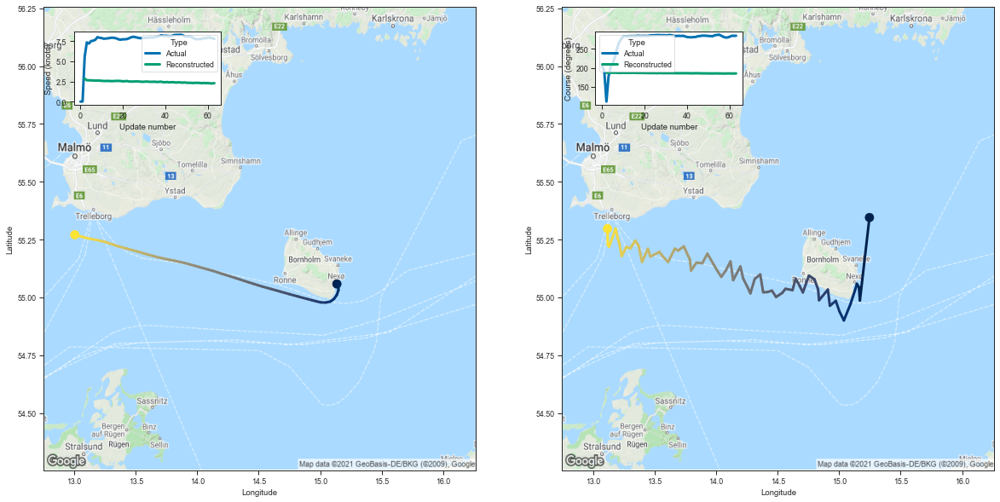

[2.849496603012085, 2.651007890701294, 2.6428844928741455, 2.6357057094573975]


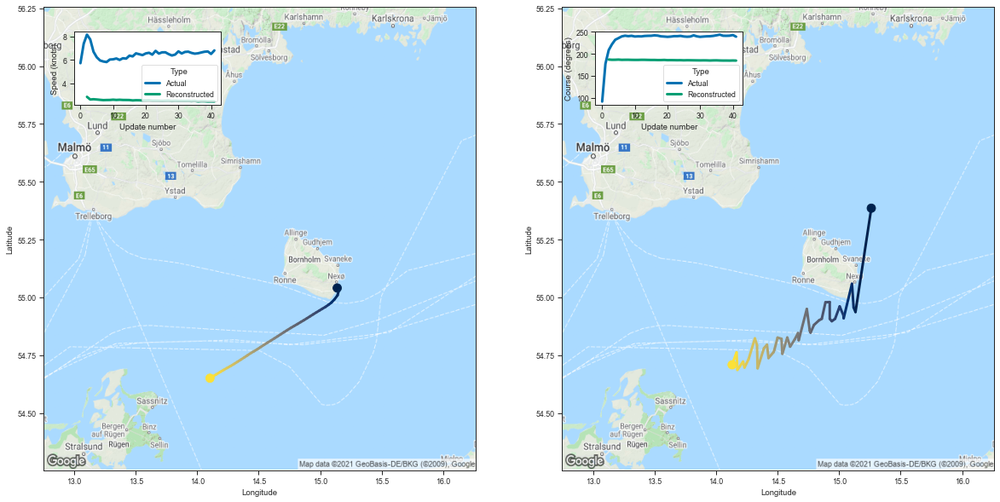

[2.8637888431549072, 2.6368777751922607, 2.659433603286743, 2.6376407146453857]


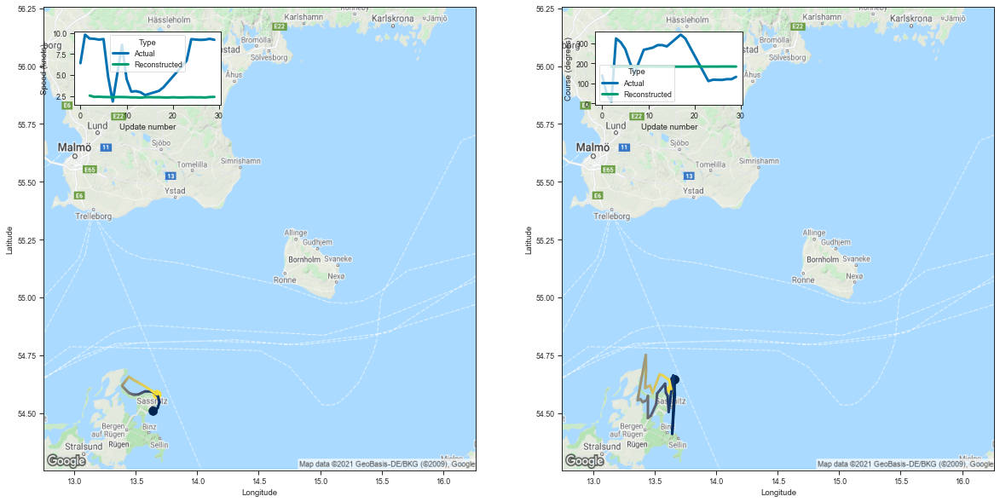

[2.5428378582000732, 2.3863117694854736, 2.4057977199554443, 2.3744008541107178]


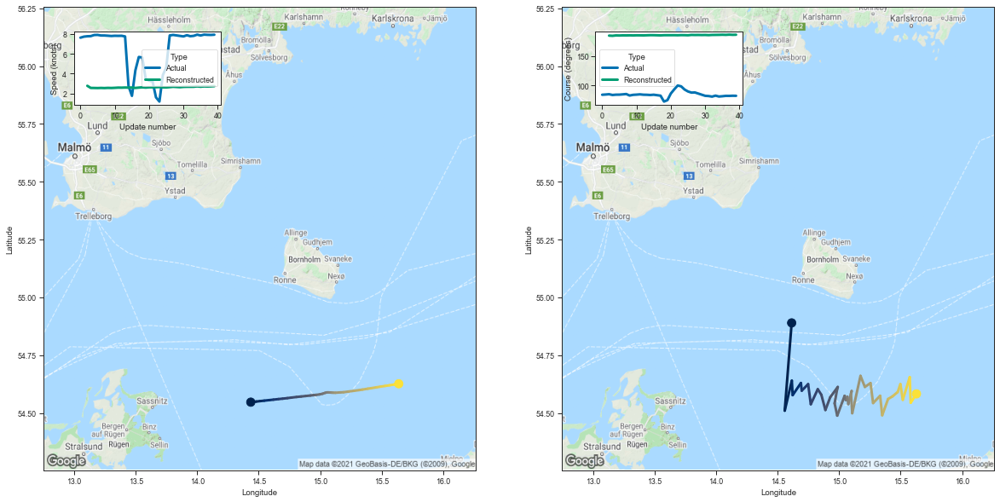

[2.769169569015503, 2.556044816970825, 2.5508878231048584, 2.5434491634368896]


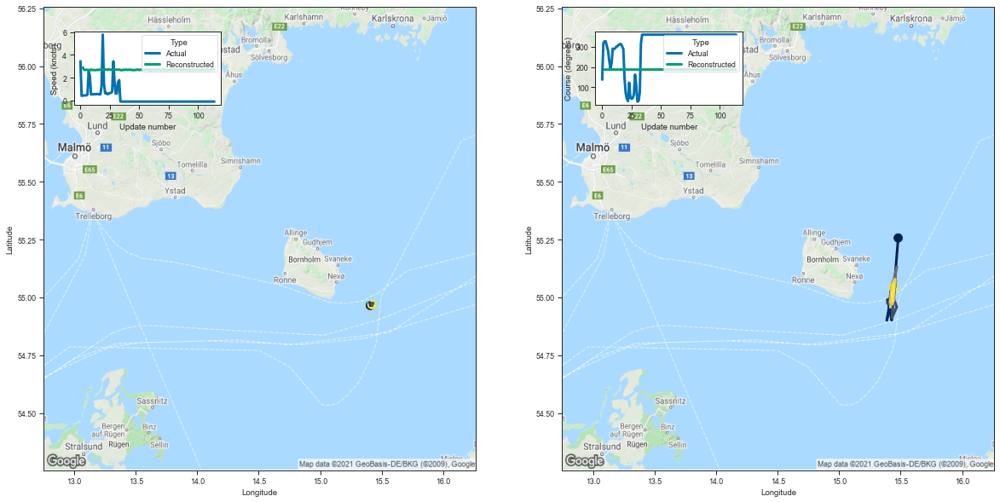

[2.899785280227661, 2.694856882095337, 2.6645519733428955, 2.687891721725464]


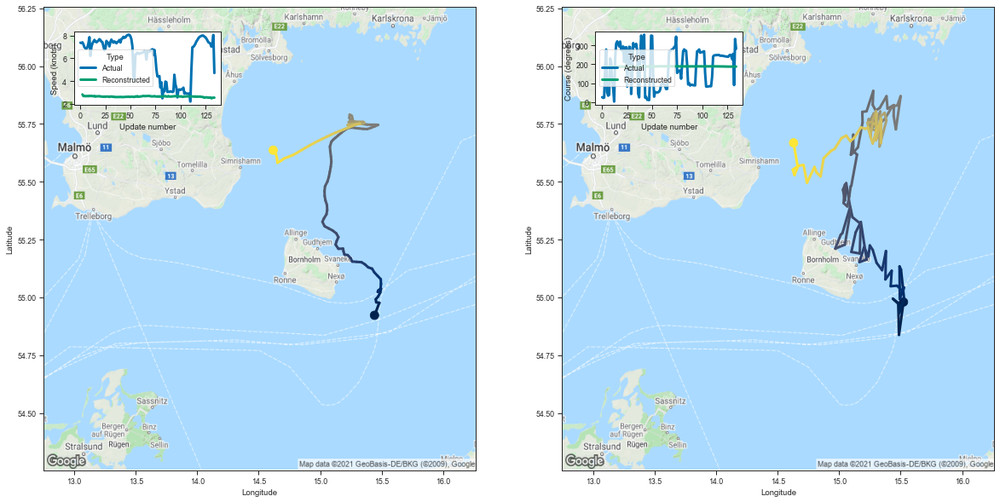

[2.8353164196014404, 2.687631845474243, 2.717686414718628, 2.676274061203003]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-550.088867,-10.186831
101,101,1176042,211755650,Fishing,30,-260.157379,-8.671913
97,97,7993496,273513600,Fishing,68,-492.231628,-7.238700
6,6,7960421,273294000,Fishing,72,-493.698730,-6.856927
37,37,1615516,220339000,Fishing,64,-408.560303,-6.383755
24,24,1074633,211474000,Fishing,42,-259.339264,-6.174744
73,73,1113112,211542610,Fishing,30,-182.241486,-6.074716
67,67,1070020,211474000,Fishing,40,-241.324677,-6.033117
56,56,4380691,261017210,Fishing,115,-690.763550,-6.006640
49,49,1557318,219021428,Fishing,135,-783.740234,-5.805483


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr5e-05_S50070010001300_05050706.pth


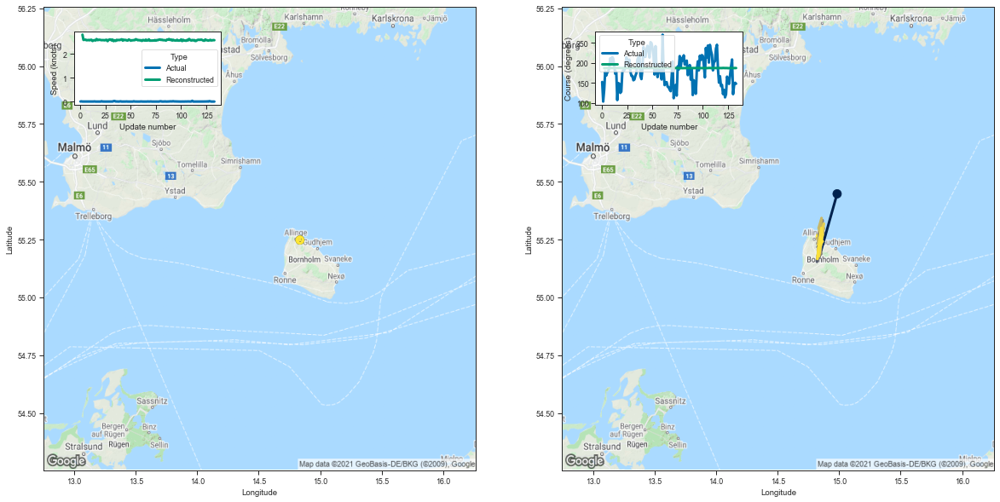

[2.809574842453003, 2.586603879928589, 2.5929462909698486, 2.6005470752716064]


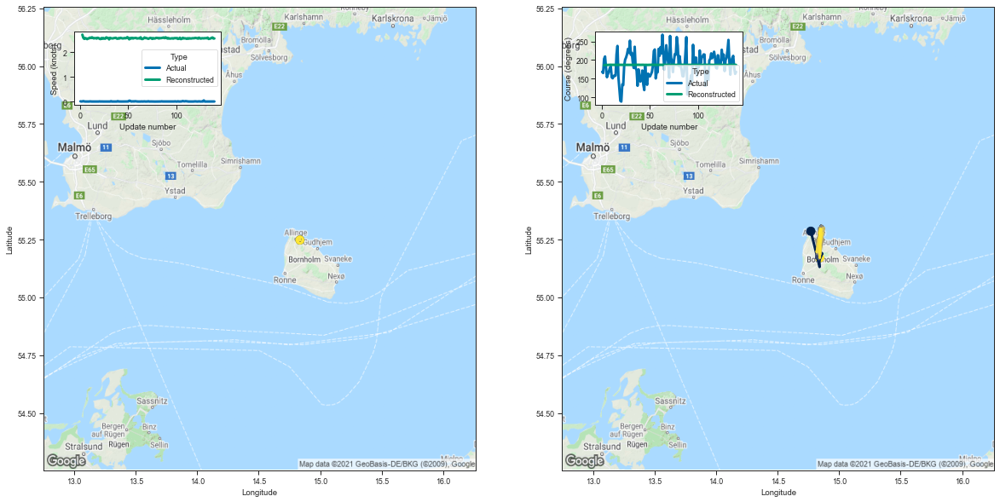

[2.720731019973755, 2.5940706729888916, 2.5484273433685303, 2.5817224979400635]


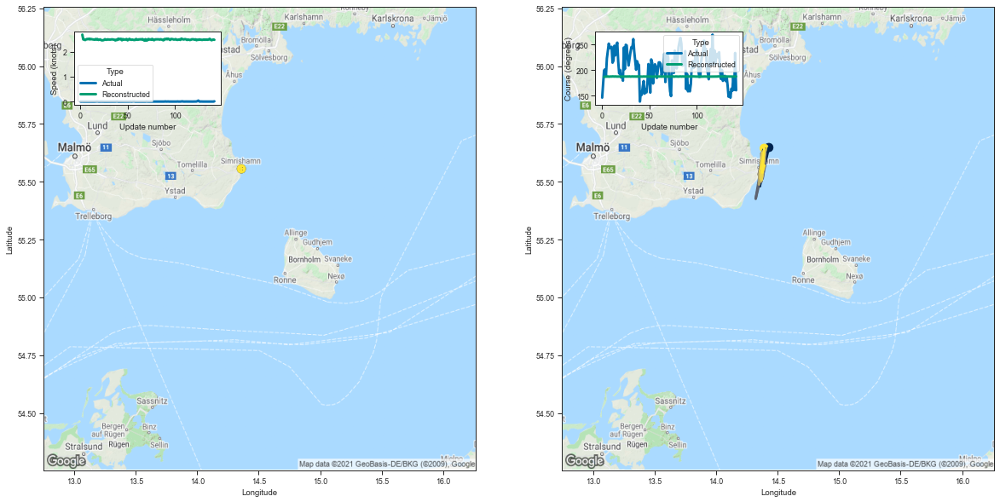

[2.6900336742401123, 2.4968483448028564, 2.491037607192993, 2.472954511642456]


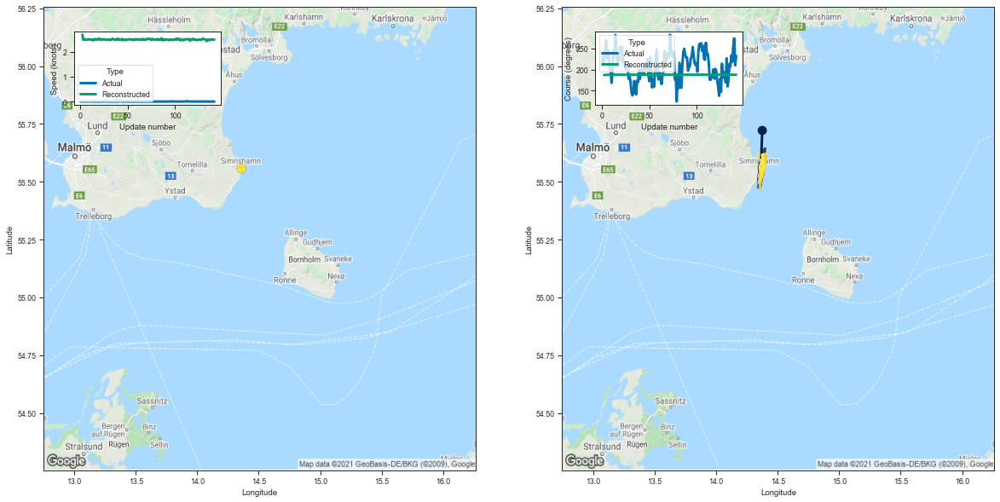

[2.6961166858673096, 2.4865615367889404, 2.4902827739715576, 2.513106107711792]


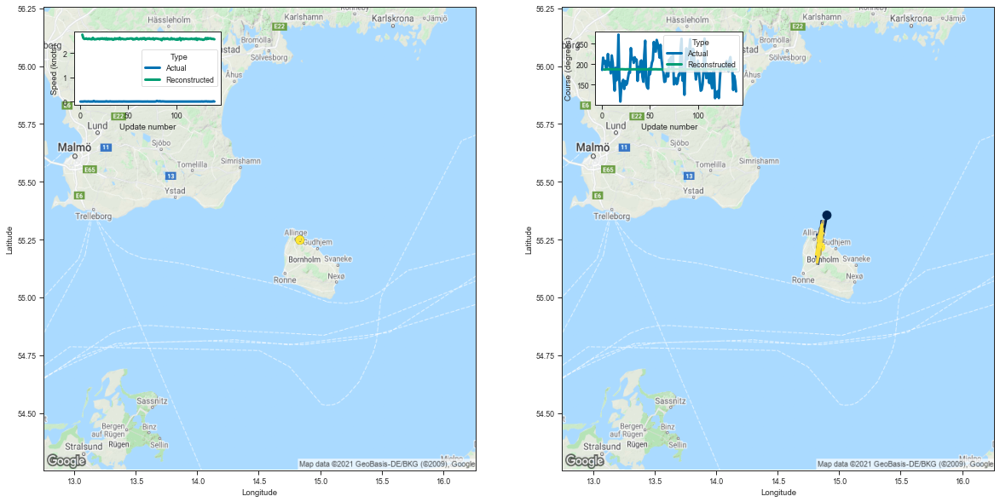

[2.7523844242095947, 2.611217737197876, 2.5752475261688232, 2.5803072452545166]


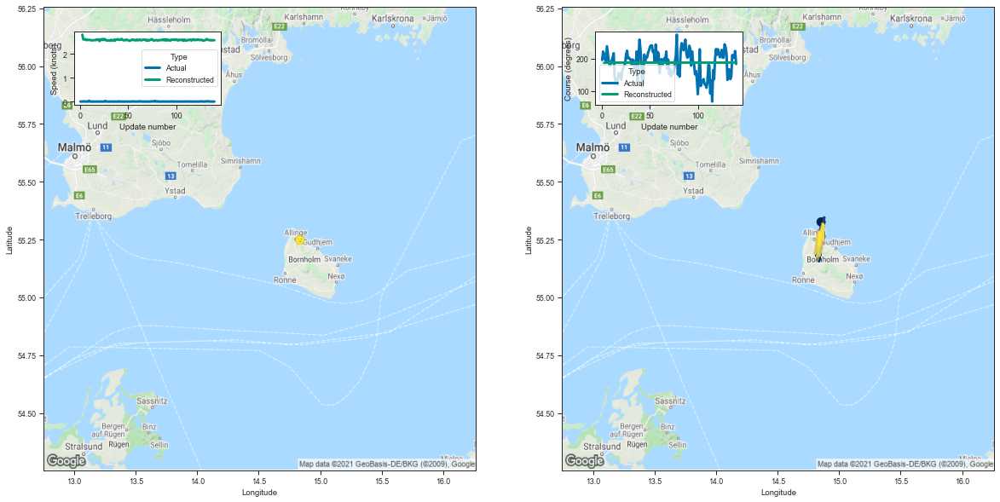

[2.7992184162139893, 2.597245454788208, 2.602343797683716, 2.6075823307037354]


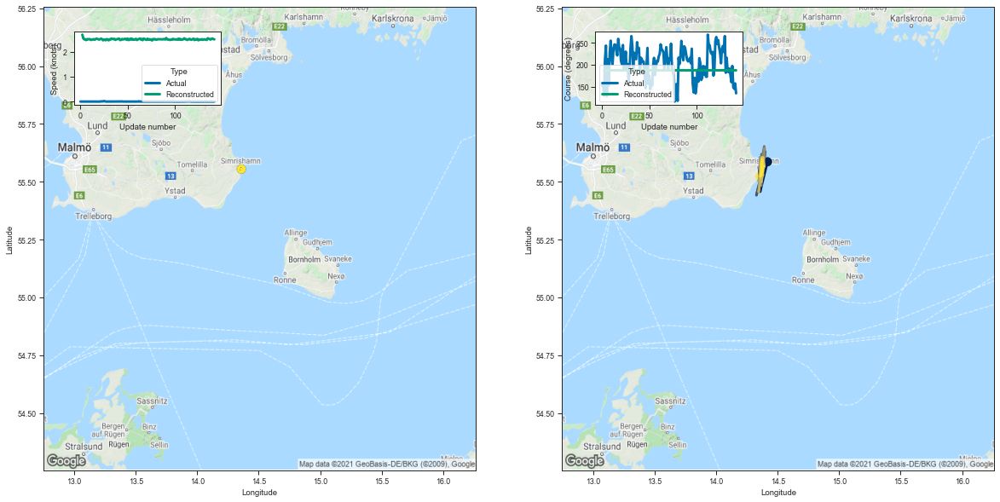

[2.6838037967681885, 2.539369821548462, 2.494232416152954, 2.497281789779663]


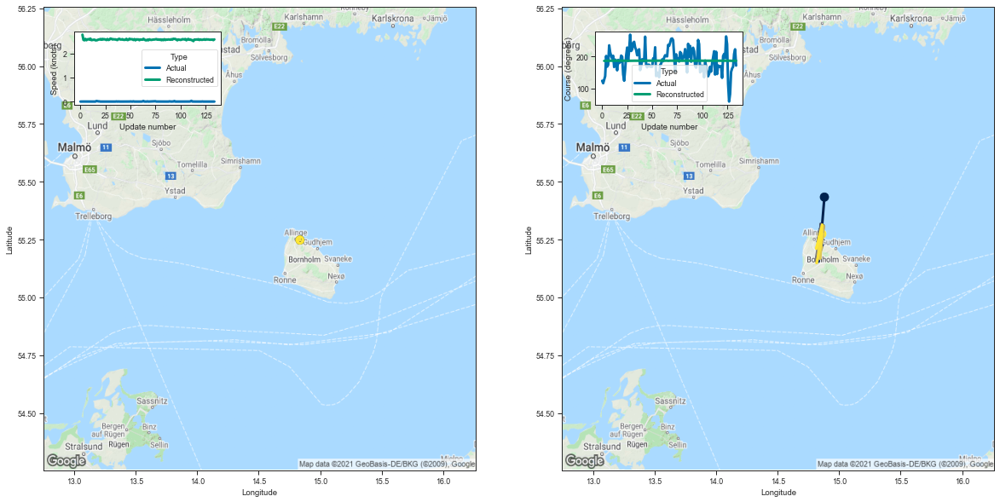

[2.7843940258026123, 2.566492795944214, 2.547635316848755, 2.608057737350464]


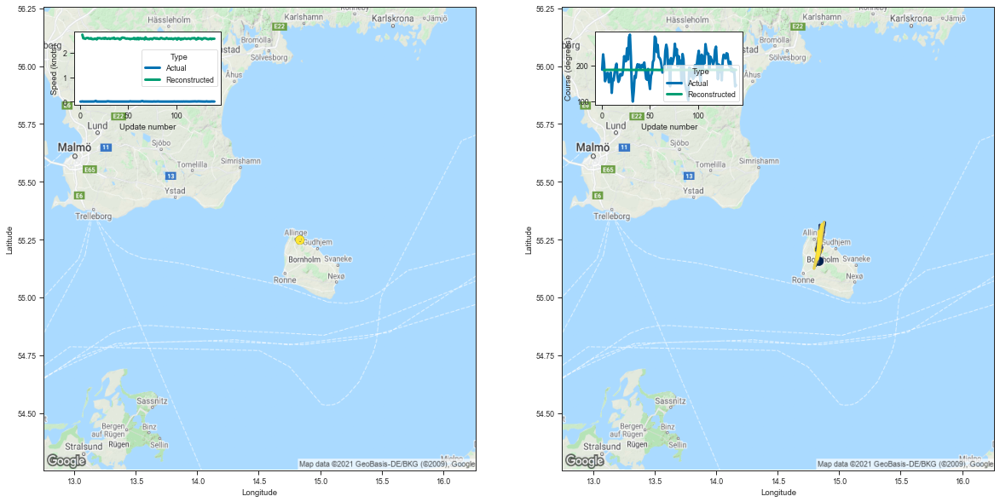

[2.740953207015991, 2.589332342147827, 2.589543104171753, 2.569295644760132]


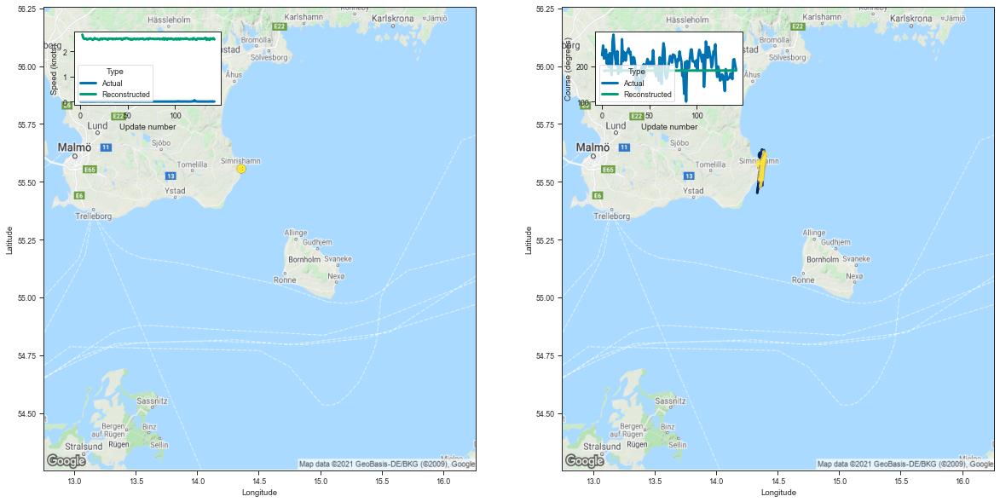

[2.6642696857452393, 2.541740655899048, 2.4914610385894775, 2.498863935470581]


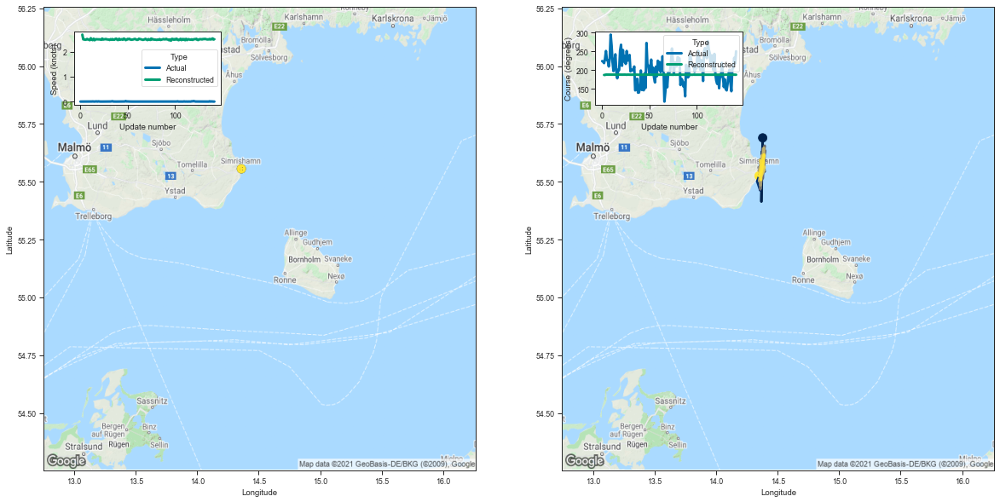

[2.6854422092437744, 2.494666814804077, 2.4948337078094482, 2.4777824878692627]


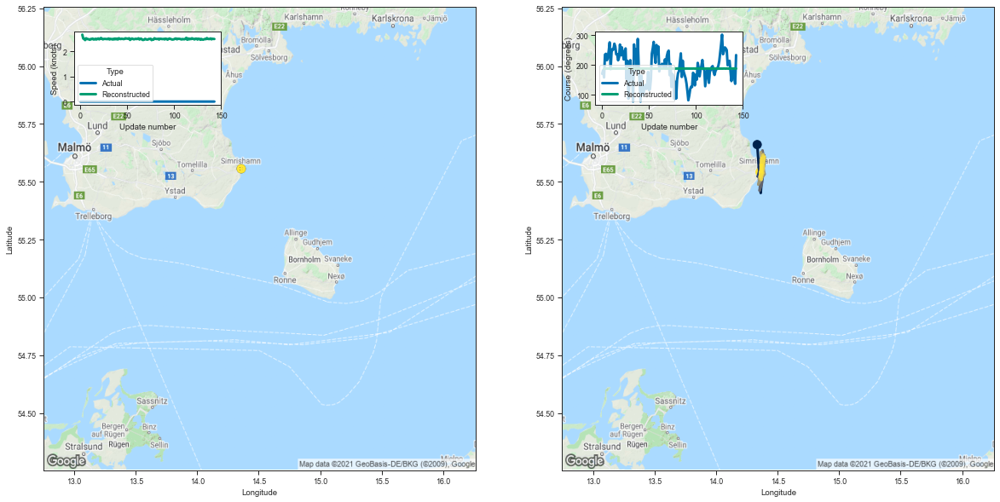

[2.6711819171905518, 2.5163204669952393, 2.4961626529693604, 2.4538590908050537]


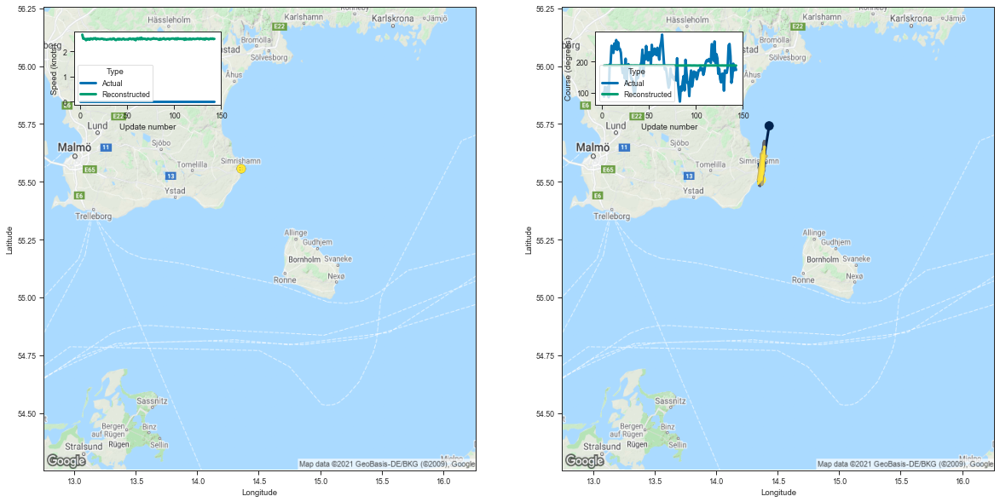

[2.6690709590911865, 2.5069515705108643, 2.5076873302459717, 2.495786428451538]


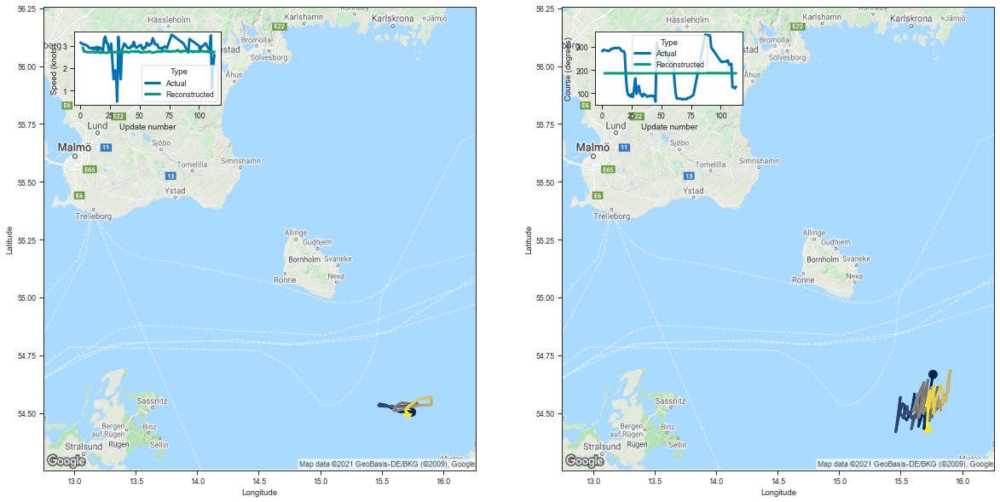

[2.925309419631958, 2.7397348880767822, 2.7480995655059814, 2.7301642894744873]


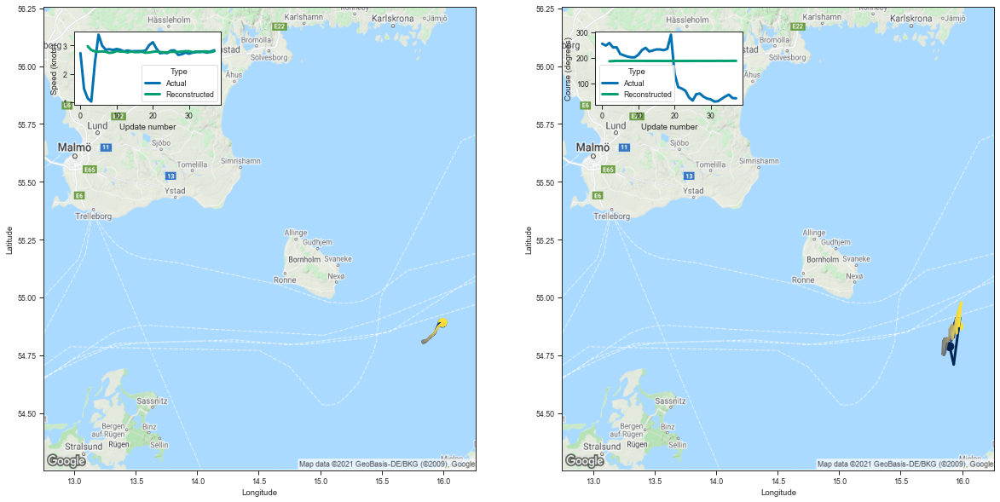

[2.9716098308563232, 2.837455987930298, 2.792226552963257, 2.779452085494995]


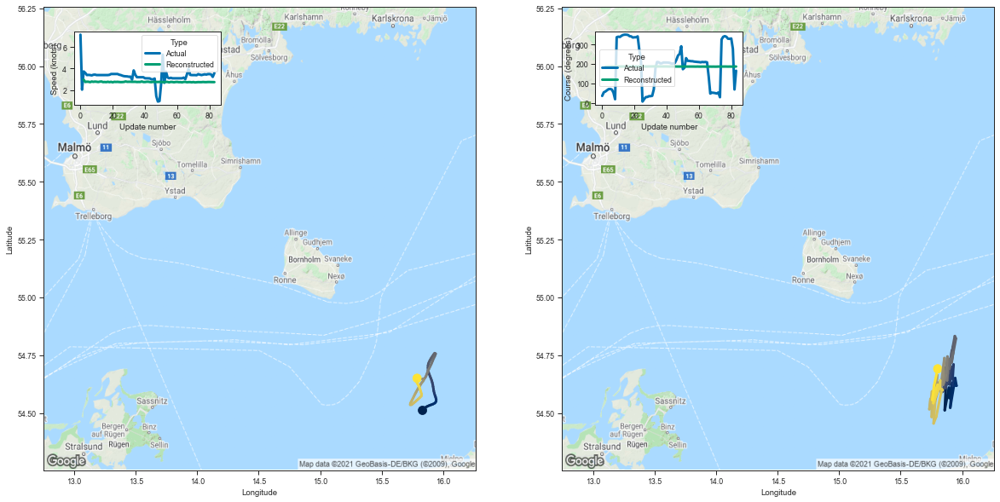

[2.9725711345672607, 2.757614850997925, 2.784618616104126, 2.778704881668091]


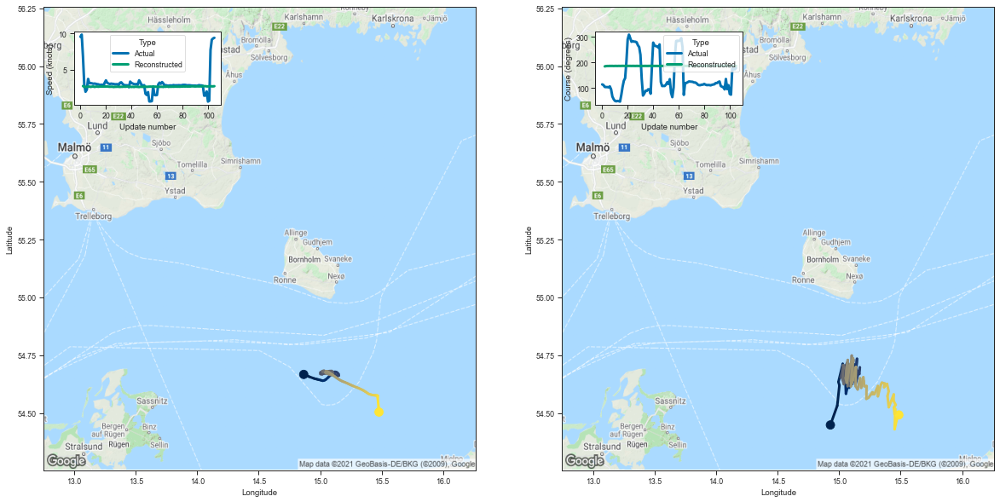

[2.719932794570923, 2.6016414165496826, 2.583883047103882, 2.614248037338257]


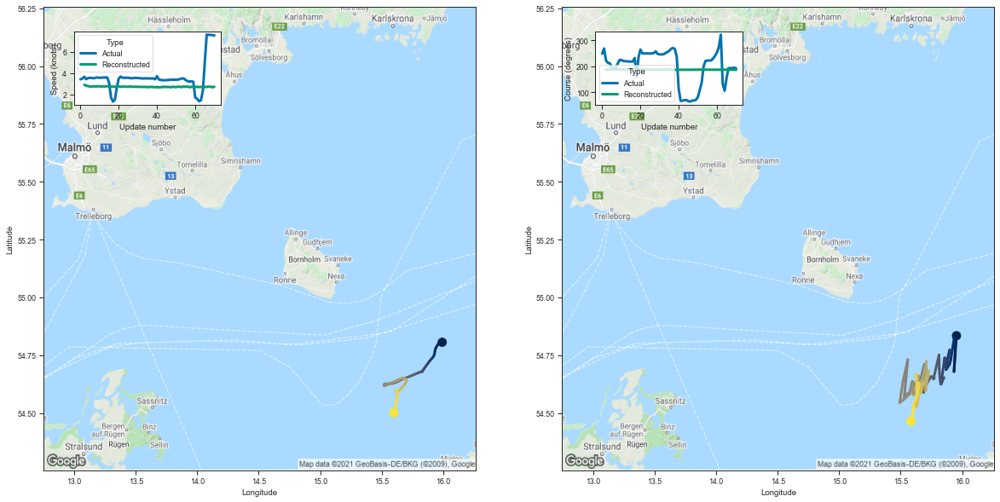

[2.918536901473999, 2.8278257846832275, 2.792340040206909, 2.7572848796844482]


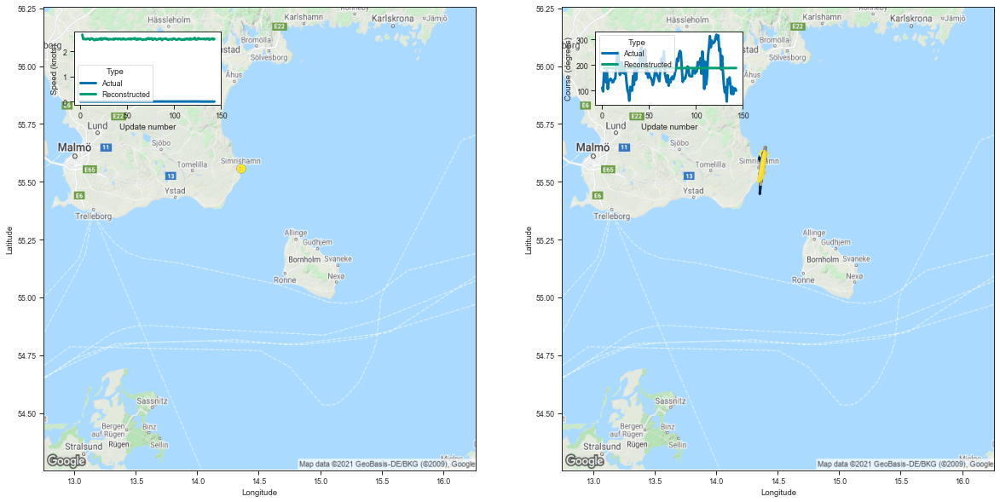

[2.67065167427063, 2.496378183364868, 2.494039297103882, 2.496676206588745]


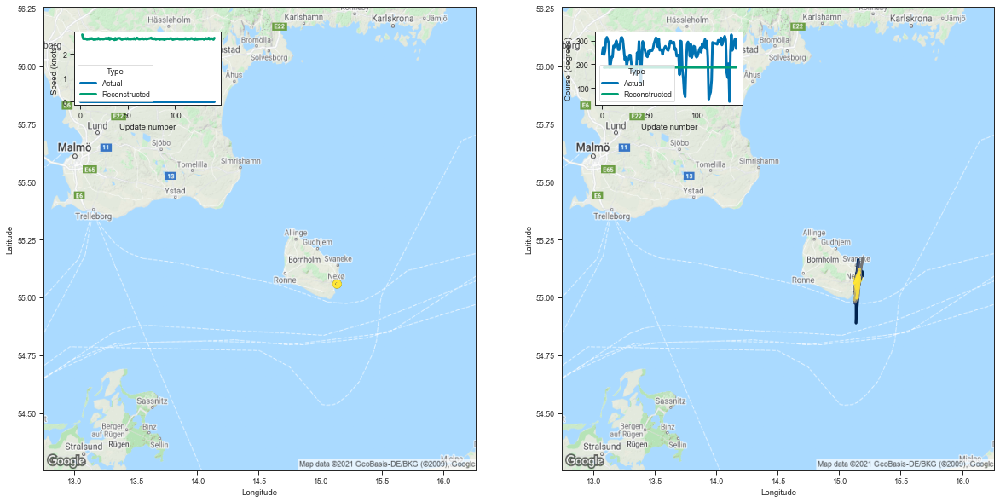

[2.806729555130005, 2.6357805728912354, 2.625035524368286, 2.64574933052063]


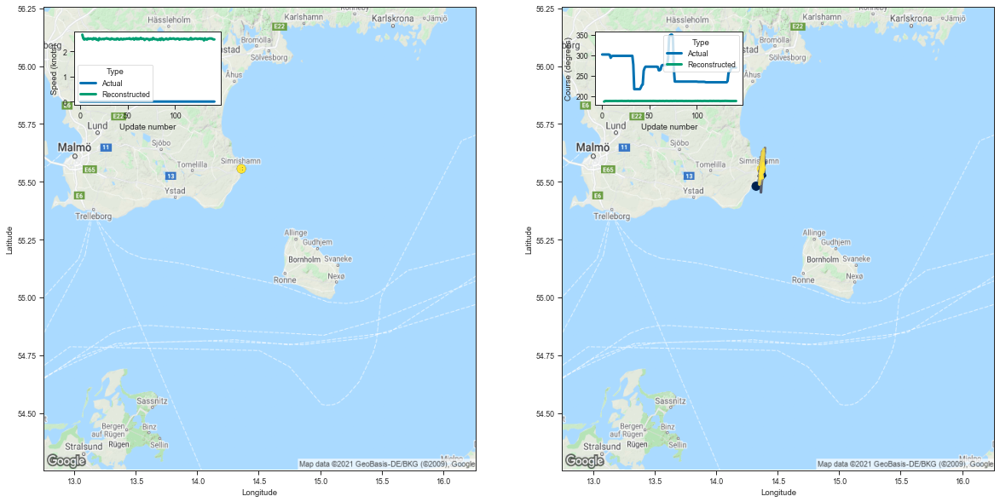

[2.6673152446746826, 2.5220396518707275, 2.4705302715301514, 2.5005762577056885]


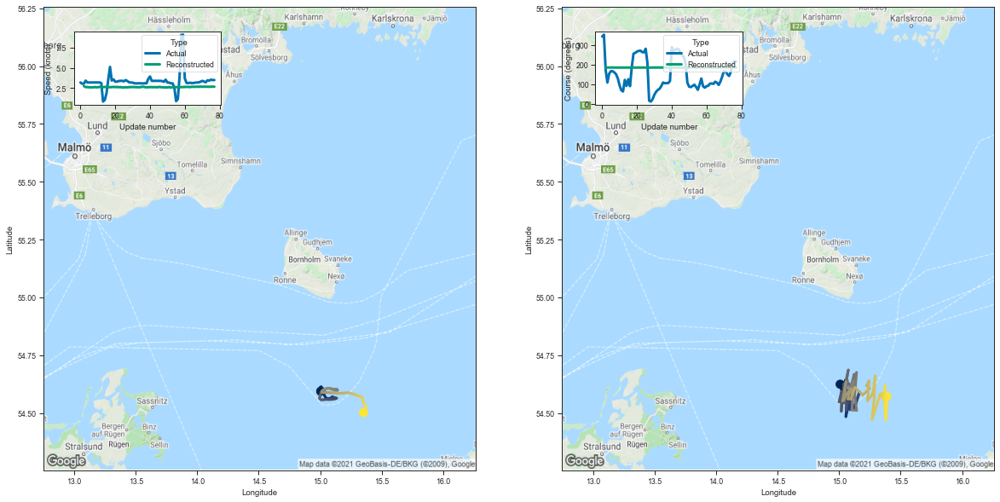

[2.751837968826294, 2.624821424484253, 2.6323182582855225, 2.600980520248413]


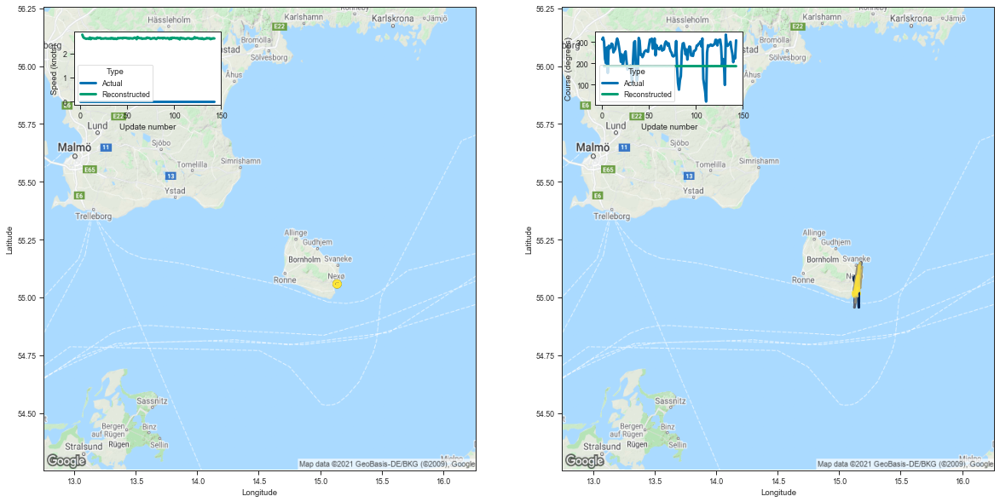

[2.7835891246795654, 2.6787455081939697, 2.6419575214385986, 2.6298816204071045]


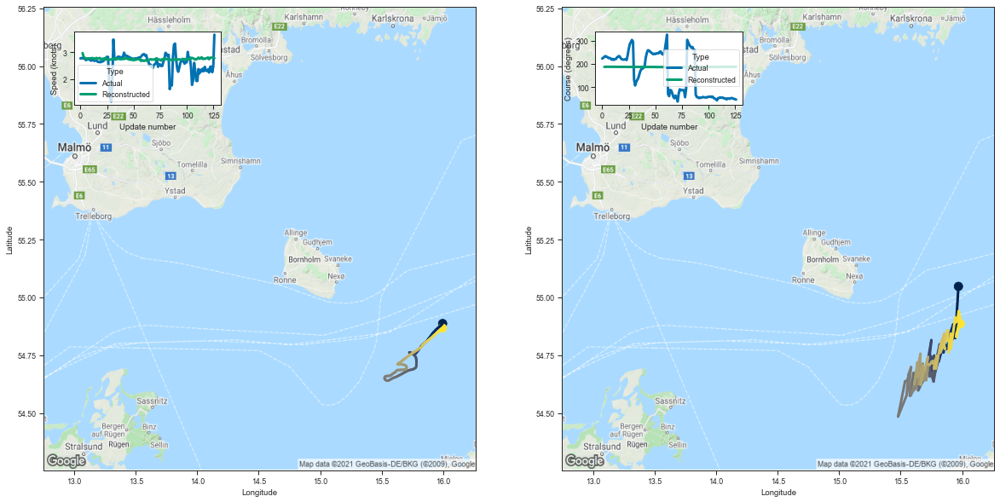

[2.9648525714874268, 2.826472520828247, 2.7881739139556885, 2.765627145767212]


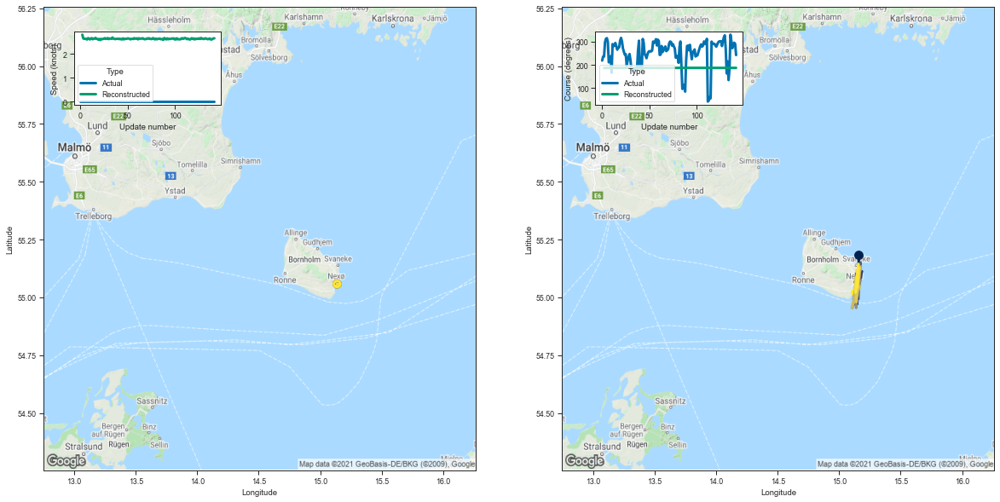

[2.8067562580108643, 2.648817777633667, 2.6313745975494385, 2.636005163192749]


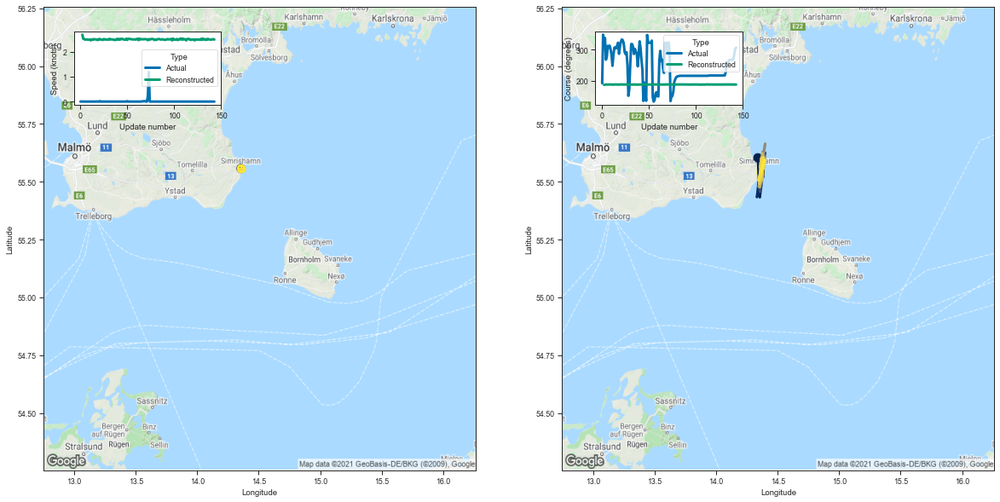

[2.68326735496521, 2.5187880992889404, 2.5060946941375732, 2.4810421466827393]


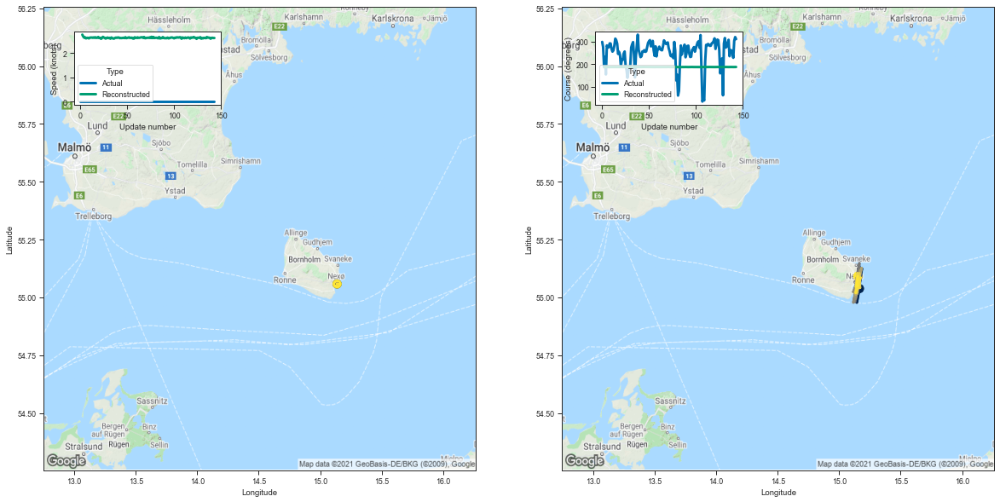

[2.7625787258148193, 2.685426950454712, 2.635913133621216, 2.6504900455474854]


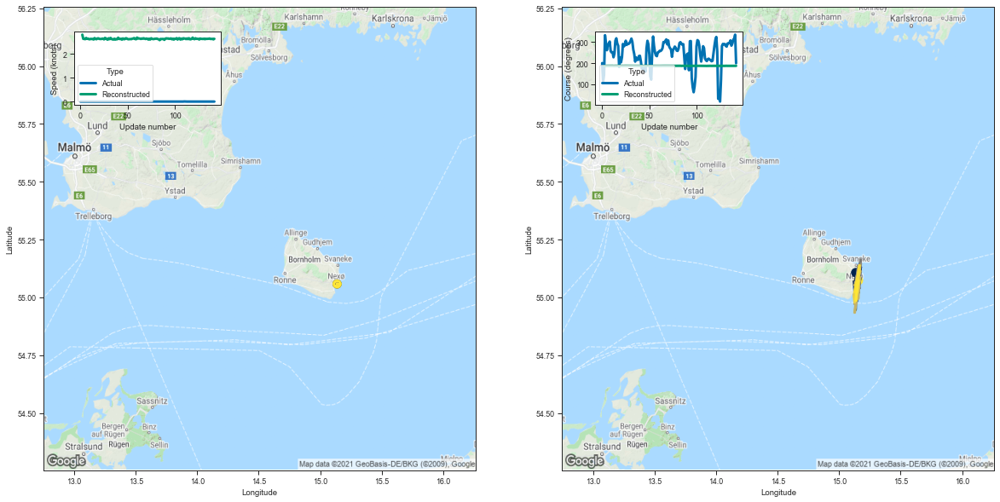

[2.8092610836029053, 2.6318719387054443, 2.629884958267212, 2.6179606914520264]


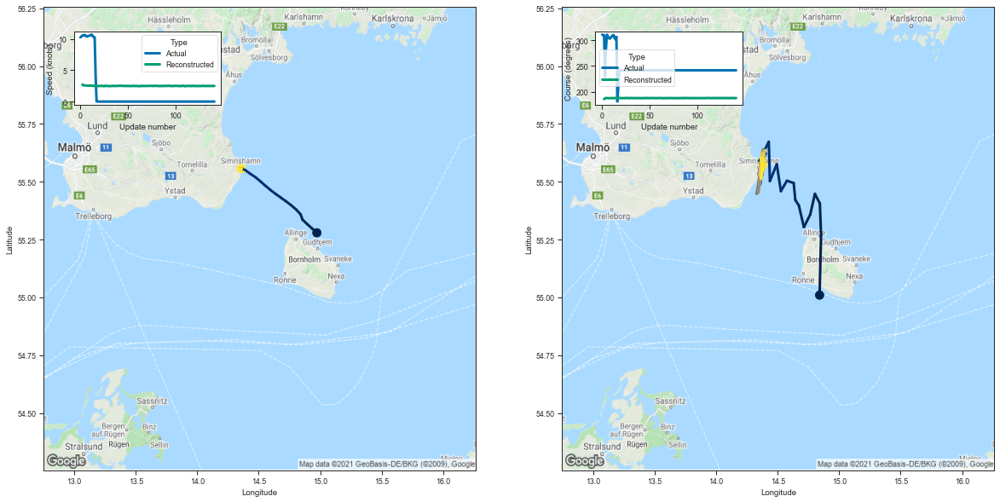

[2.7257306575775146, 2.5895192623138428, 2.598815679550171, 2.5762298107147217]


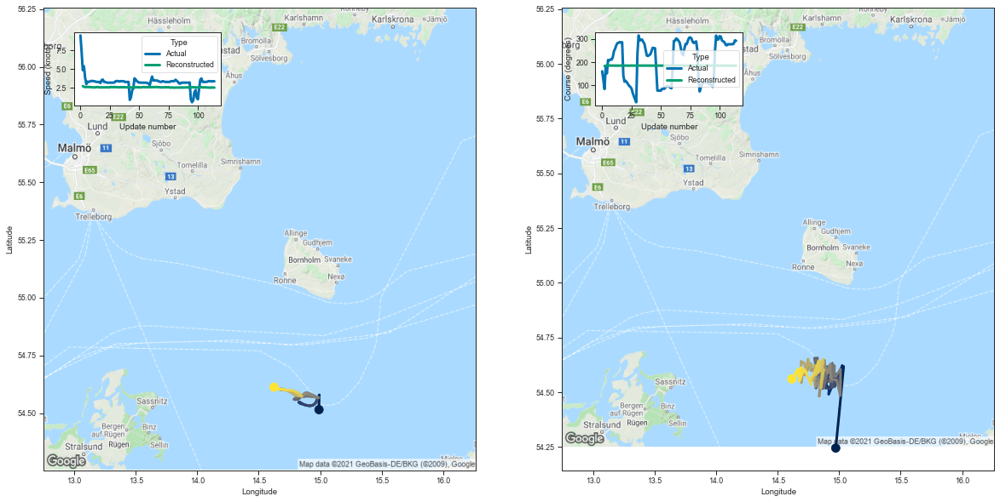

[2.751380681991577, 2.641706705093384, 2.621758222579956, 2.613729238510132]


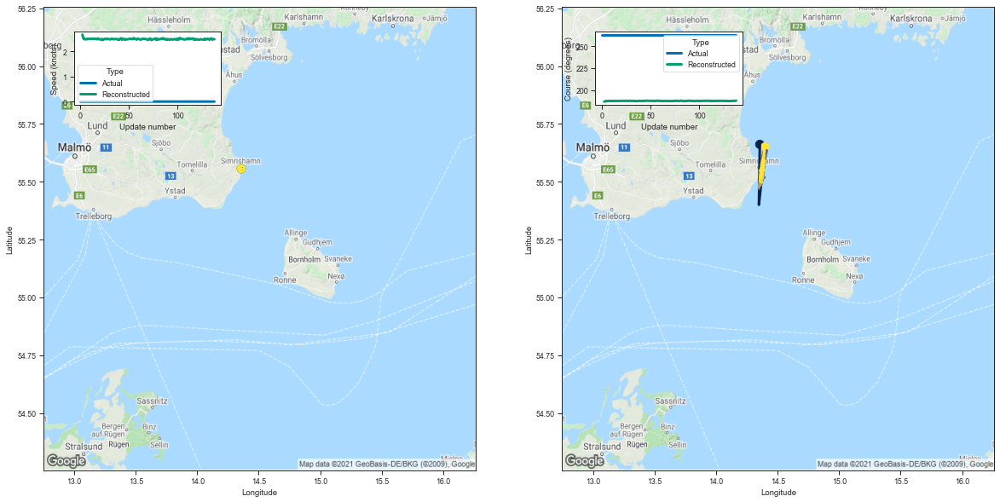

[2.672050714492798, 2.5310118198394775, 2.486840009689331, 2.5007450580596924]


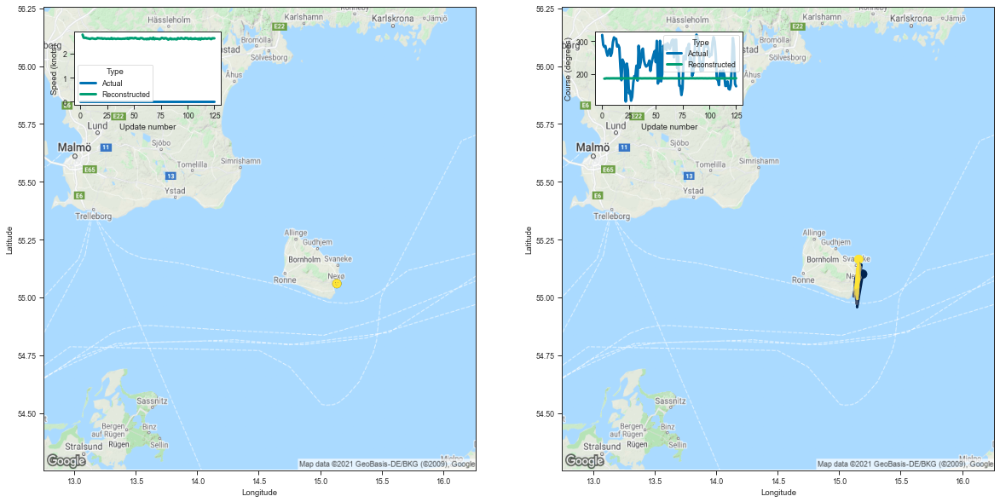

[2.7979772090911865, 2.6679890155792236, 2.662609815597534, 2.669611692428589]


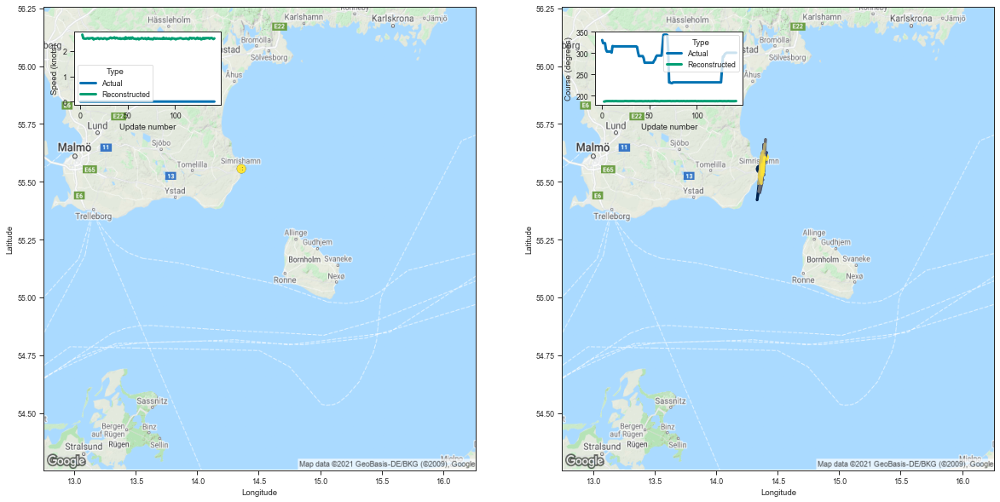

[2.647150754928589, 2.5024874210357666, 2.4887163639068604, 2.487421751022339]


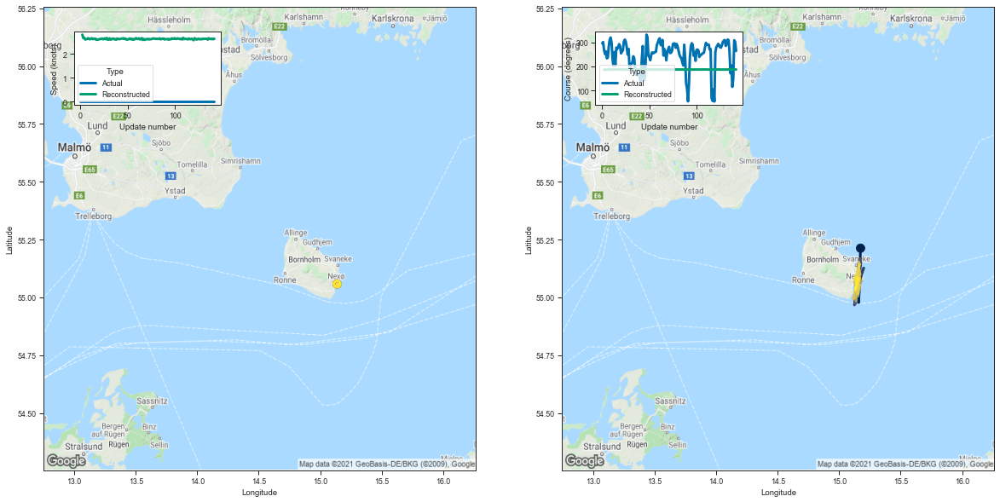

[2.8130733966827393, 2.6735265254974365, 2.6829049587249756, 2.6099441051483154]


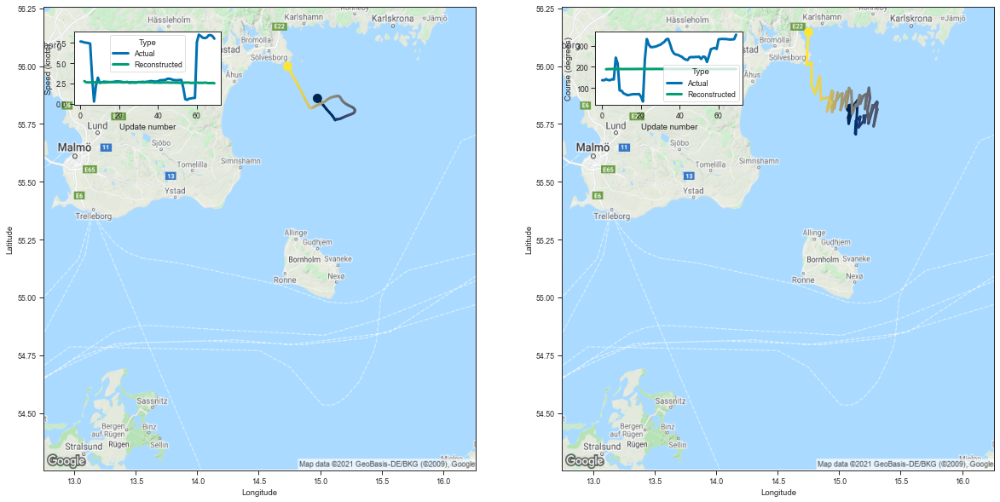

[2.7997887134552, 2.640390634536743, 2.6391255855560303, 2.640180826187134]


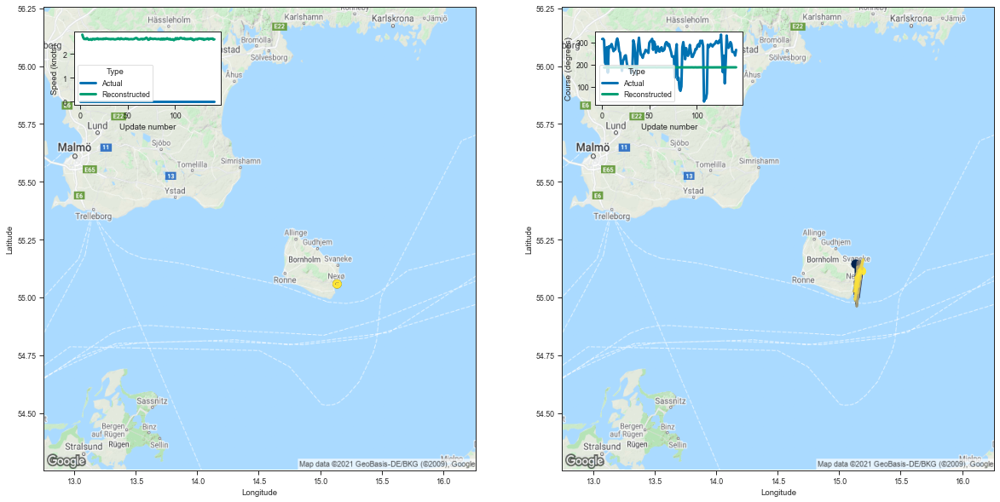

[2.816530466079712, 2.688001871109009, 2.6306984424591064, 2.634944200515747]


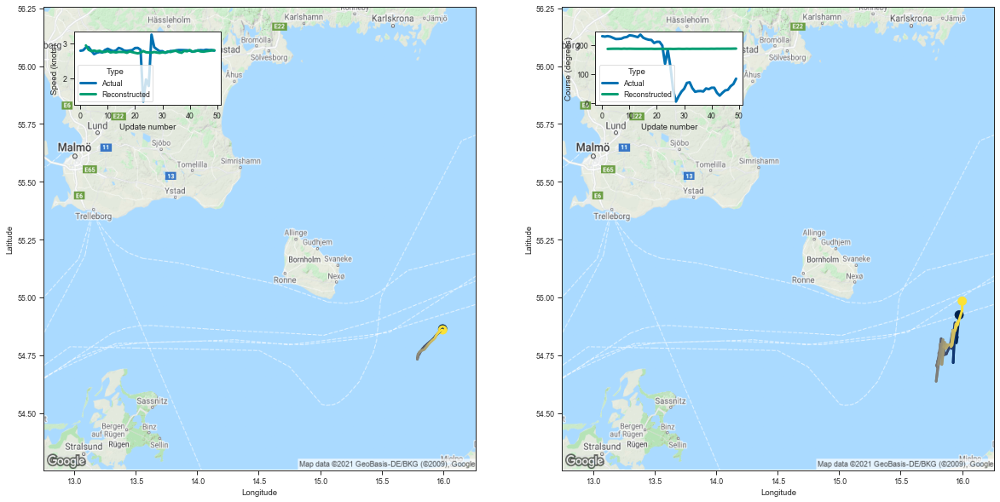

[2.936426877975464, 2.812547445297241, 2.7756922245025635, 2.7916648387908936]


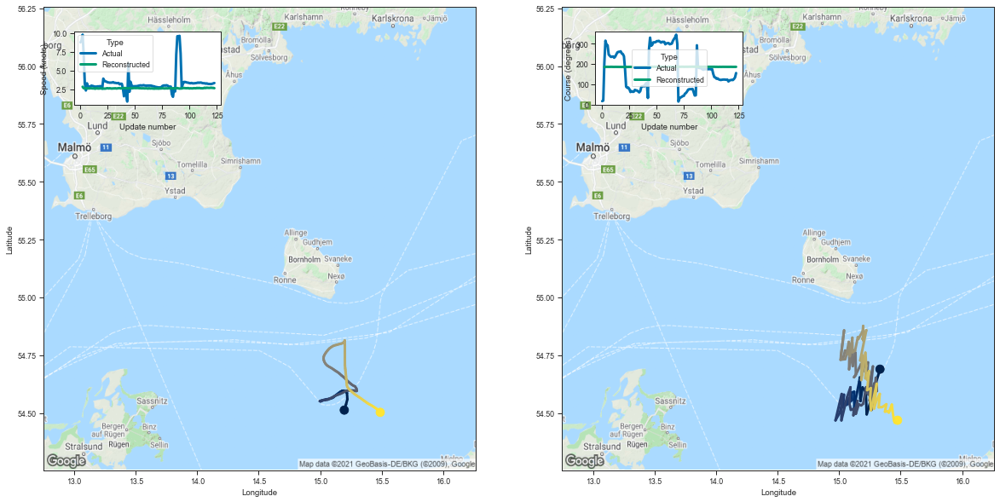

[2.845618963241577, 2.6480753421783447, 2.614353895187378, 2.635538339614868]


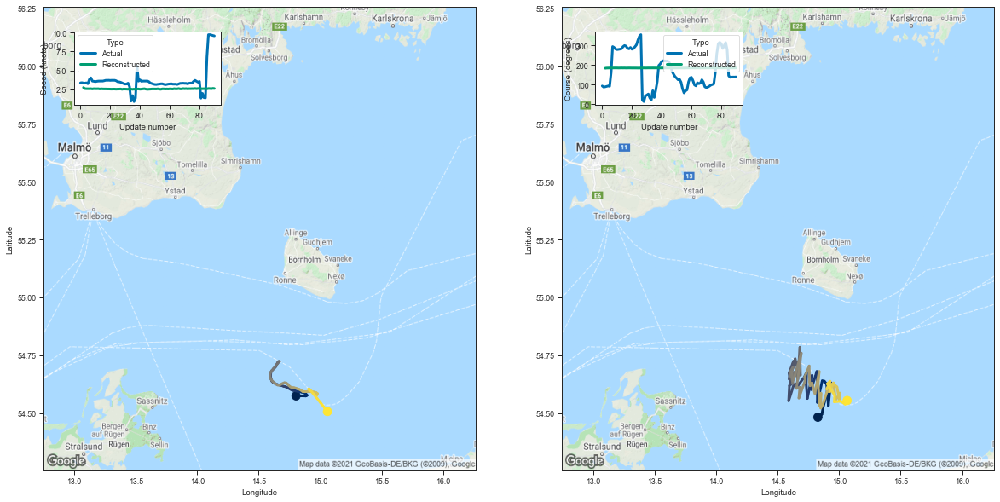

[2.7466843128204346, 2.599811315536499, 2.5870120525360107, 2.5850698947906494]


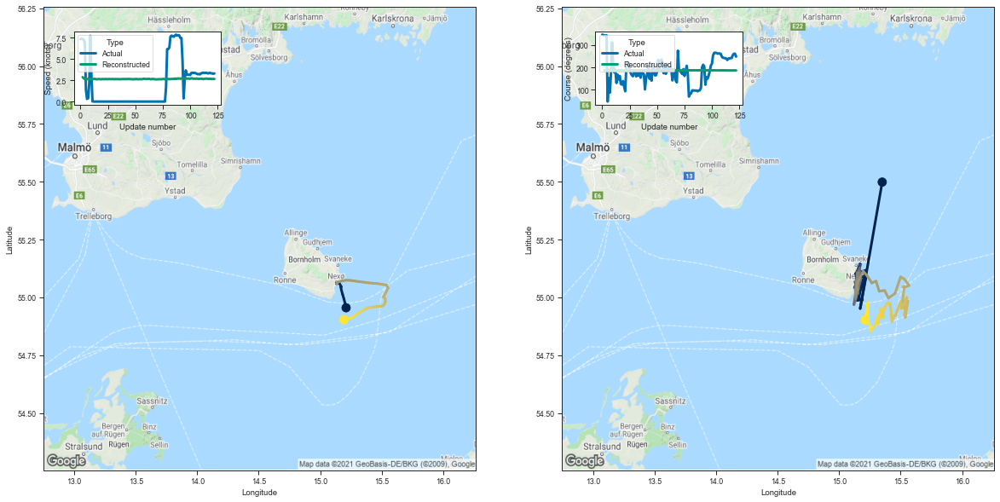

[2.8628342151641846, 2.725212335586548, 2.6406991481781006, 2.612485647201538]


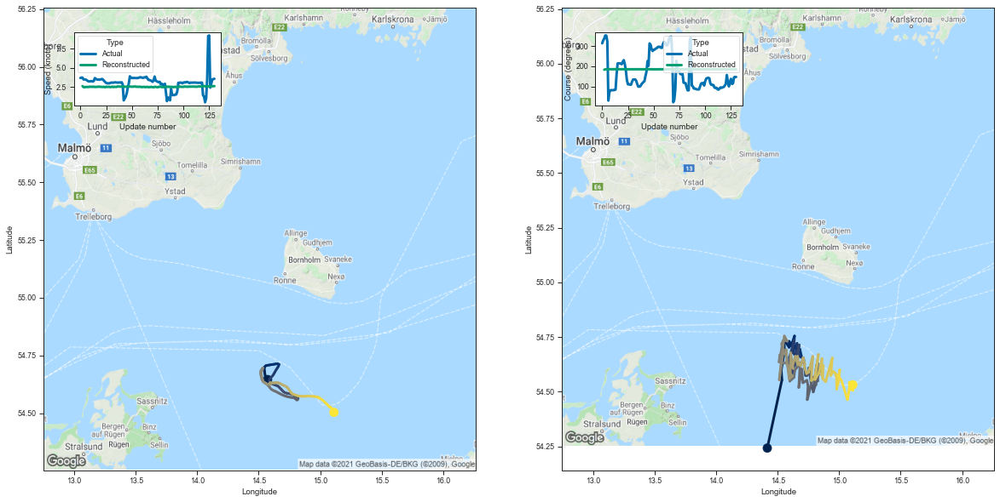

[2.6423494815826416, 2.511784315109253, 2.4921176433563232, 2.5270235538482666]


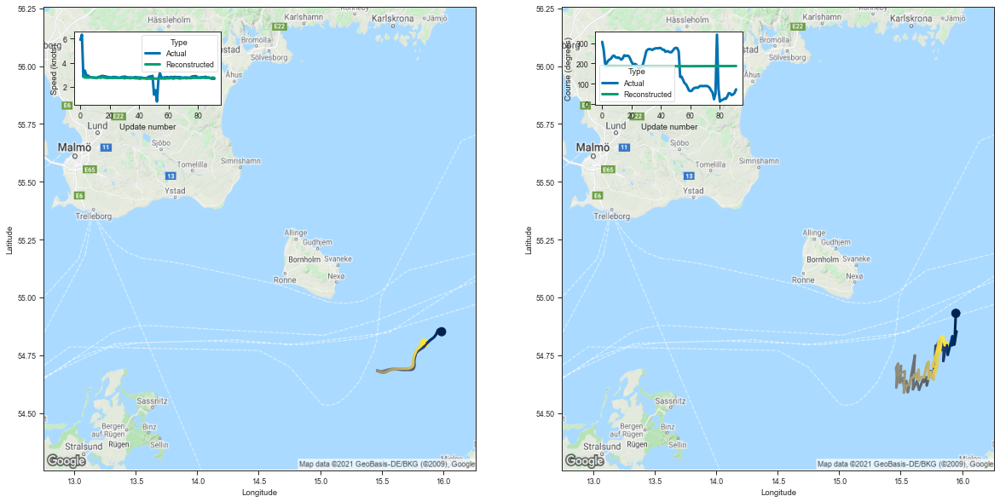

[2.9579102993011475, 2.7741453647613525, 2.770411252975464, 2.77559494972229]


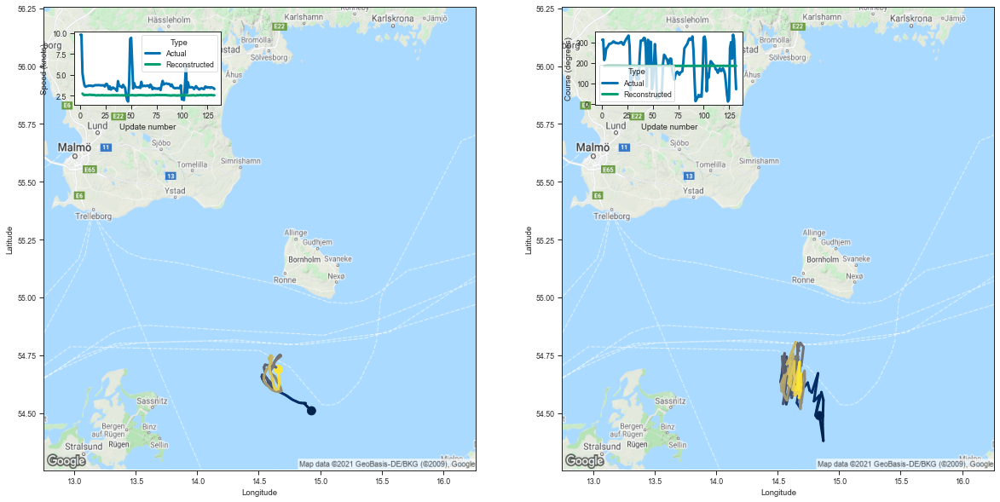

[2.73710560798645, 2.6129181385040283, 2.545219659805298, 2.586313486099243]


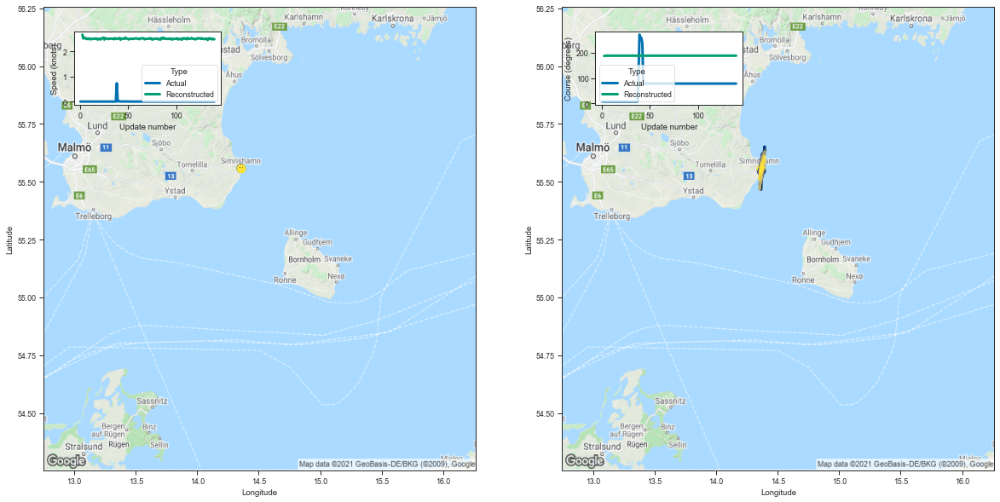

[2.659294843673706, 2.503305673599243, 2.5406582355499268, 2.5265047550201416]


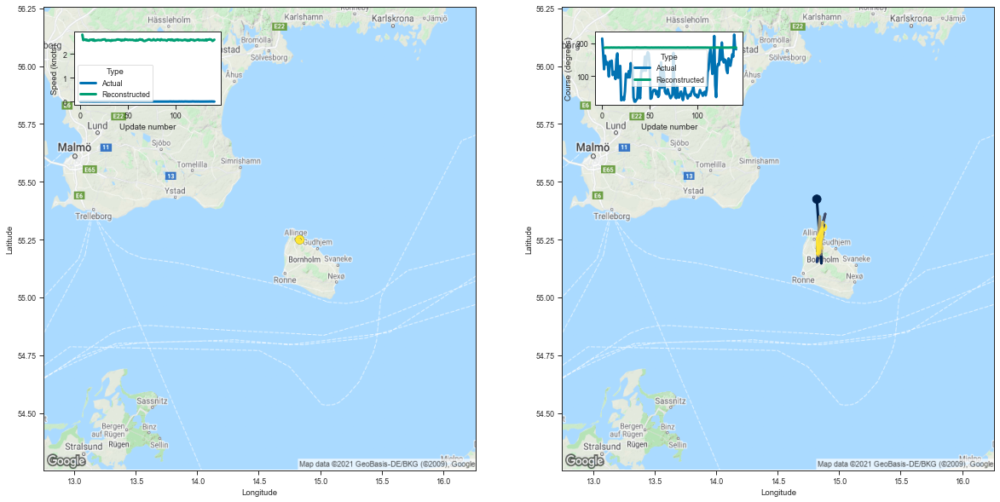

[2.80570912361145, 2.5757601261138916, 2.588855028152466, 2.60186505317688]


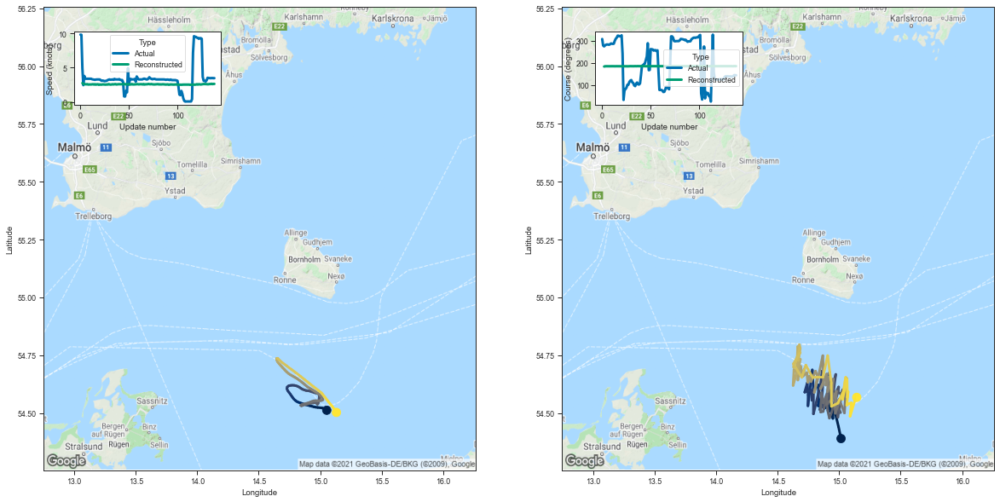

[2.7667958736419678, 2.6176207065582275, 2.63036847114563, 2.6015918254852295]


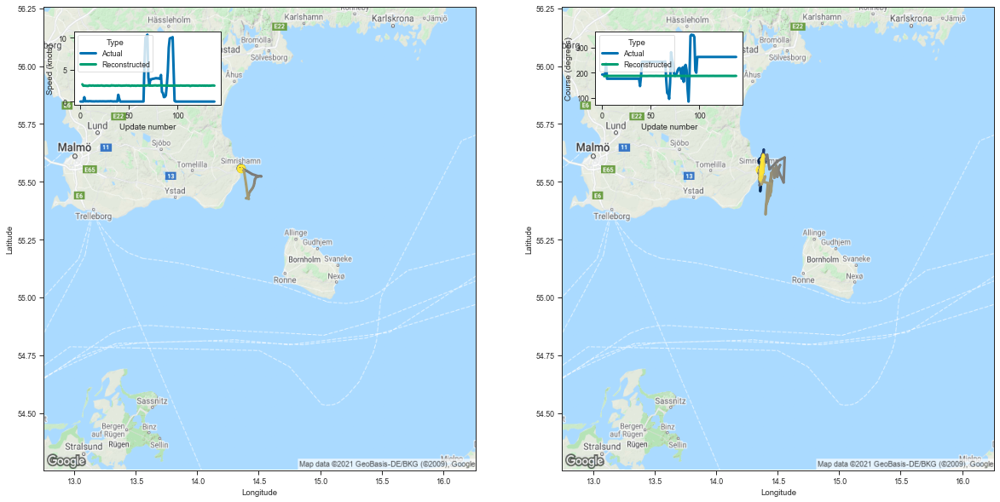

[2.705857992172241, 2.4758288860321045, 2.4871928691864014, 2.481968641281128]


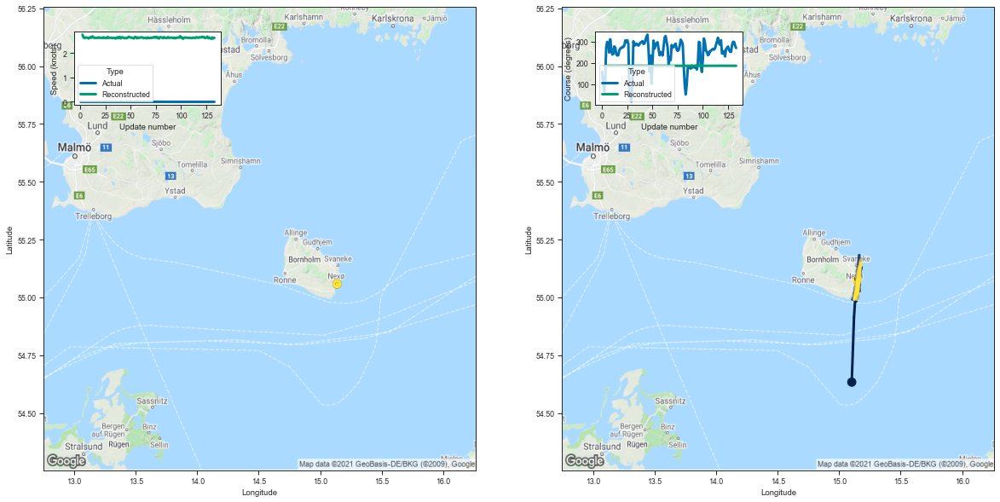

[2.7556264400482178, 2.645214319229126, 2.6109273433685303, 2.6388370990753174]


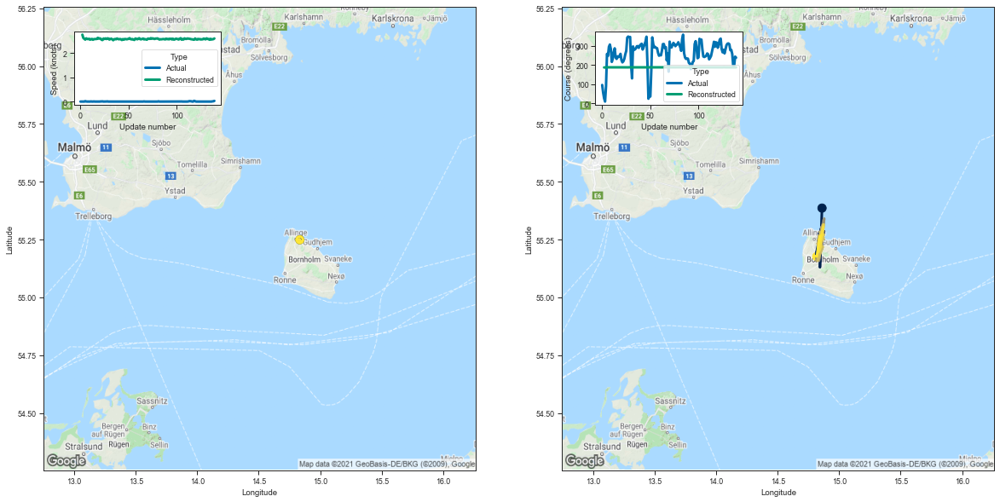

[2.7586252689361572, 2.6204240322113037, 2.588609457015991, 2.5532596111297607]


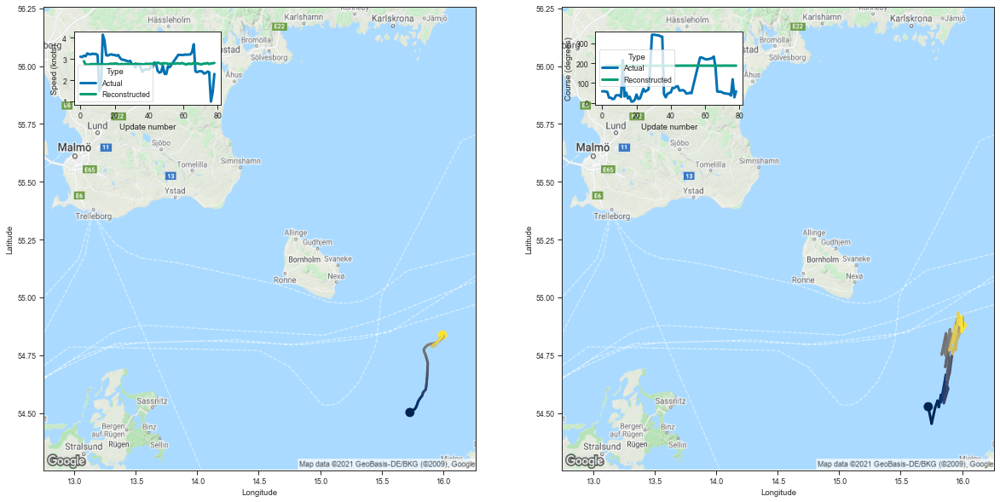

[2.899094343185425, 2.7312915325164795, 2.737304449081421, 2.732203722000122]


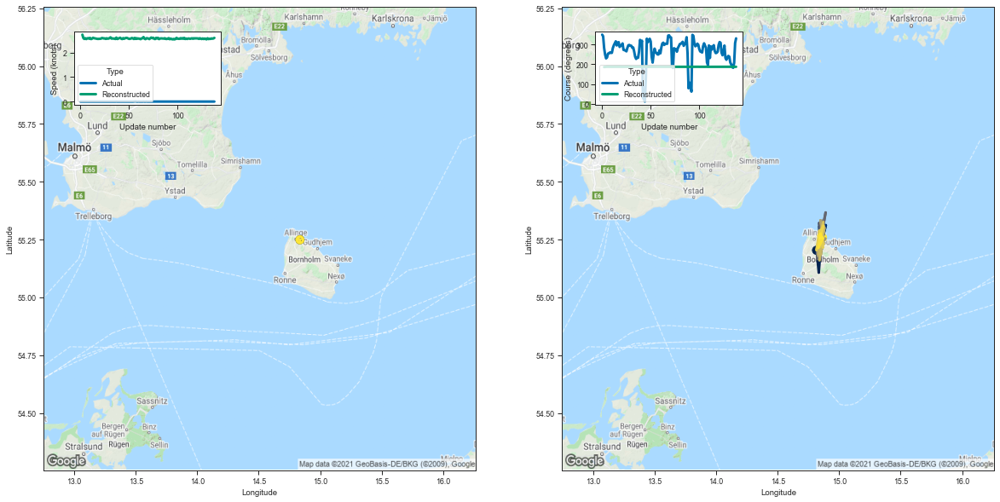

[2.737076997756958, 2.5984981060028076, 2.5591375827789307, 2.592534303665161]


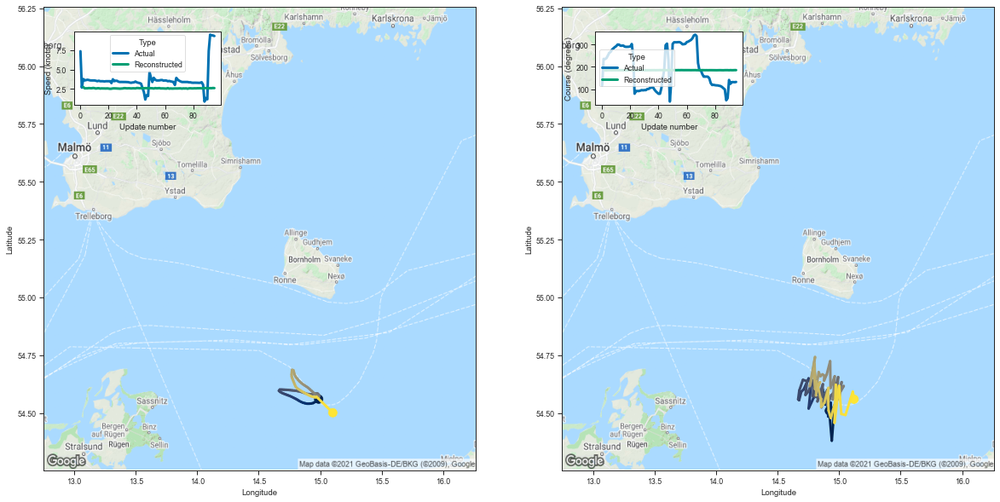

[2.7483980655670166, 2.5842926502227783, 2.5900800228118896, 2.5896918773651123]


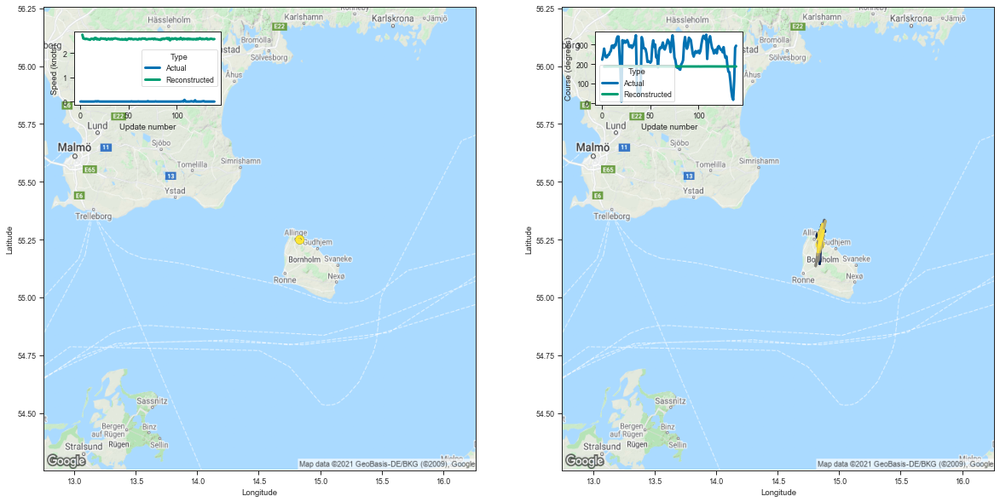

[2.758119821548462, 2.5970547199249268, 2.591031312942505, 2.5736582279205322]


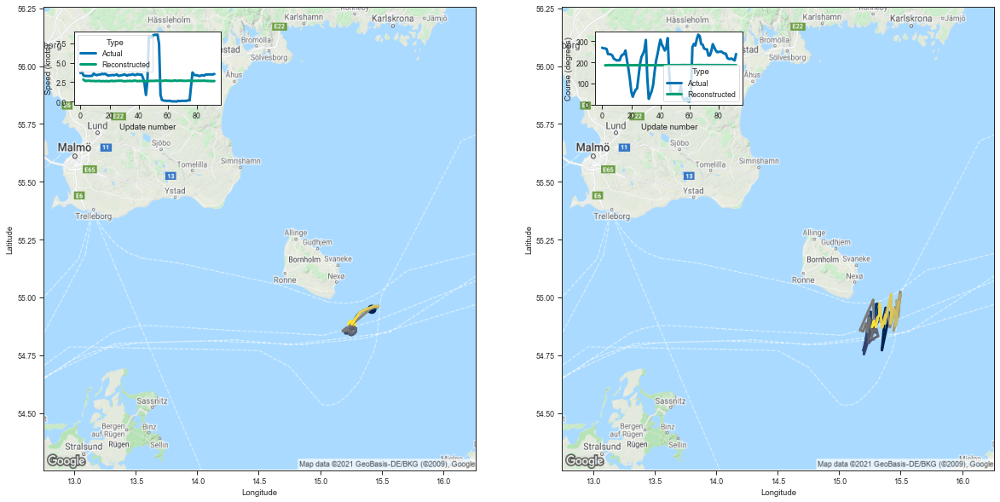

[2.84069561958313, 2.6950275897979736, 2.66349196434021, 2.6859238147735596]


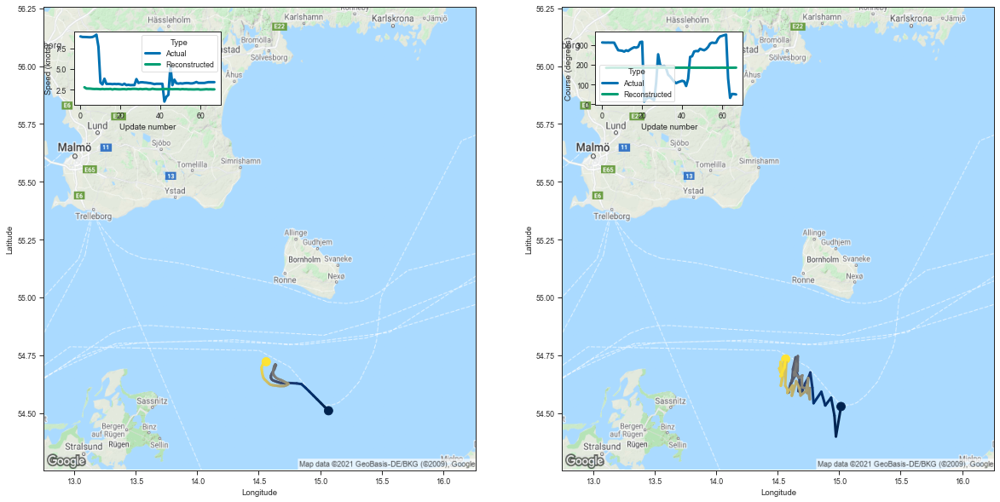

[2.779409646987915, 2.62459397315979, 2.621480703353882, 2.6114284992218018]


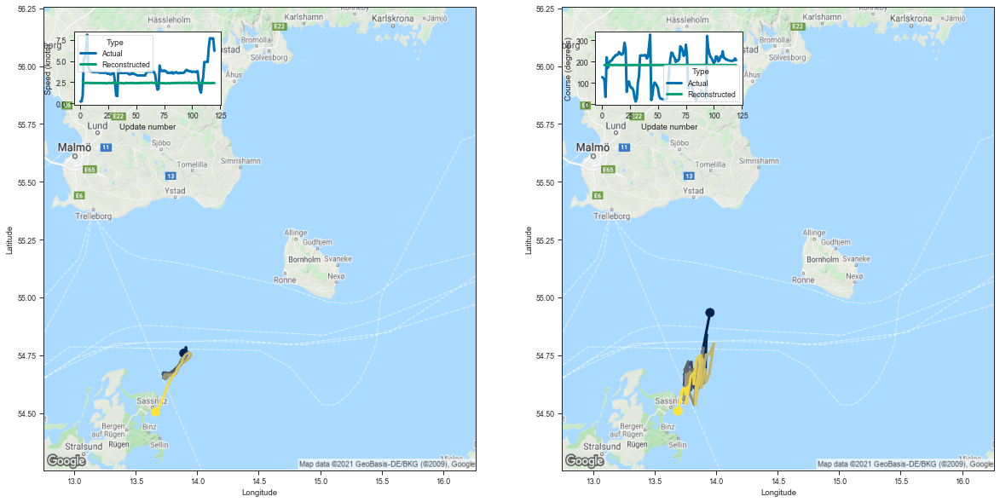

[2.6214025020599365, 2.4211437702178955, 2.3897244930267334, 2.42221999168396]


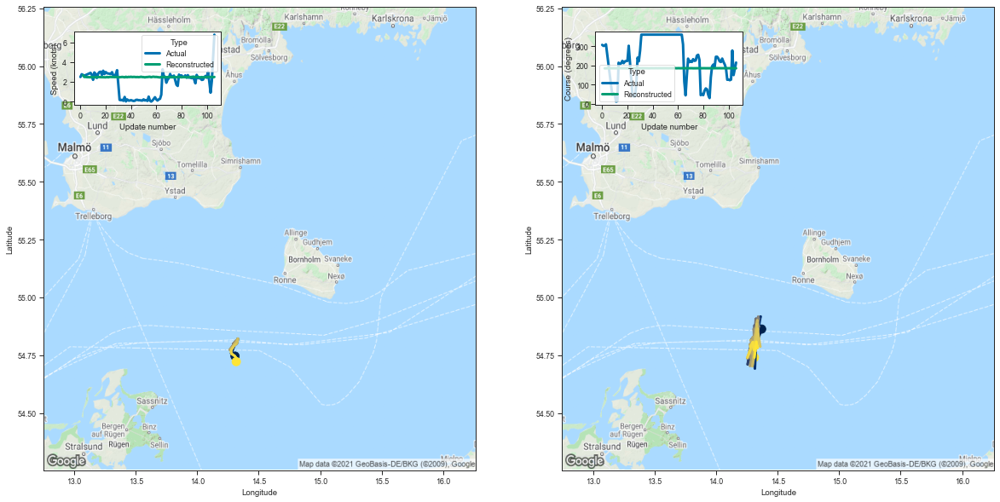

[2.6775238513946533, 2.498638868331909, 2.497542142868042, 2.4788405895233154]


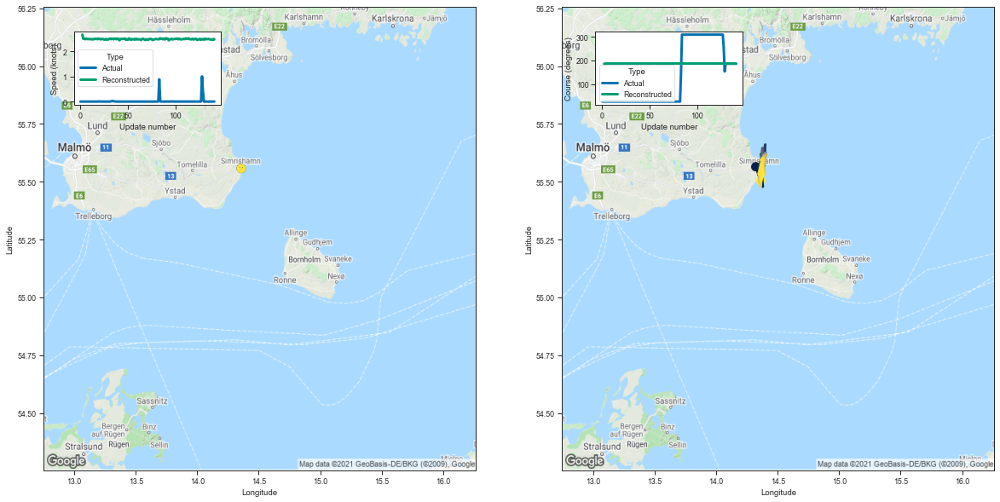

[2.6731560230255127, 2.5087802410125732, 2.5040037631988525, 2.4891417026519775]


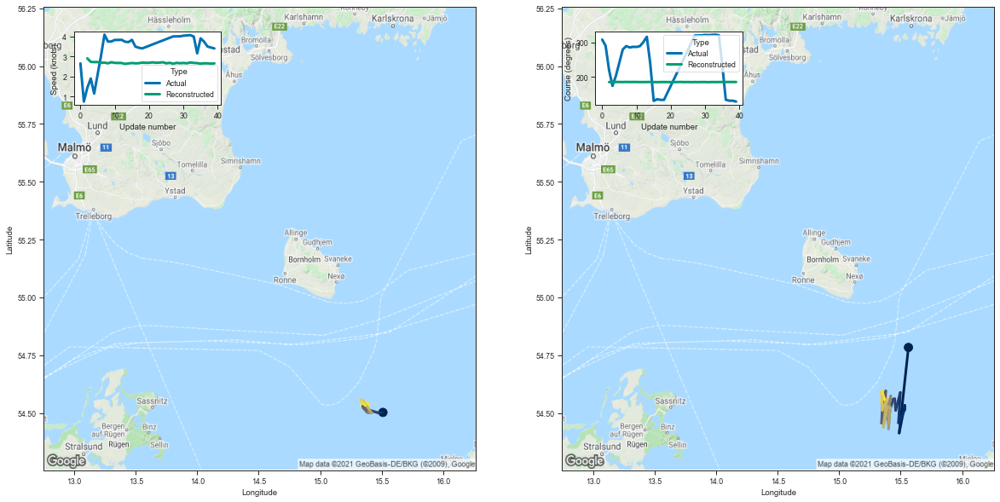

[2.9063150882720947, 2.7290399074554443, 2.7197654247283936, 2.721170663833618]


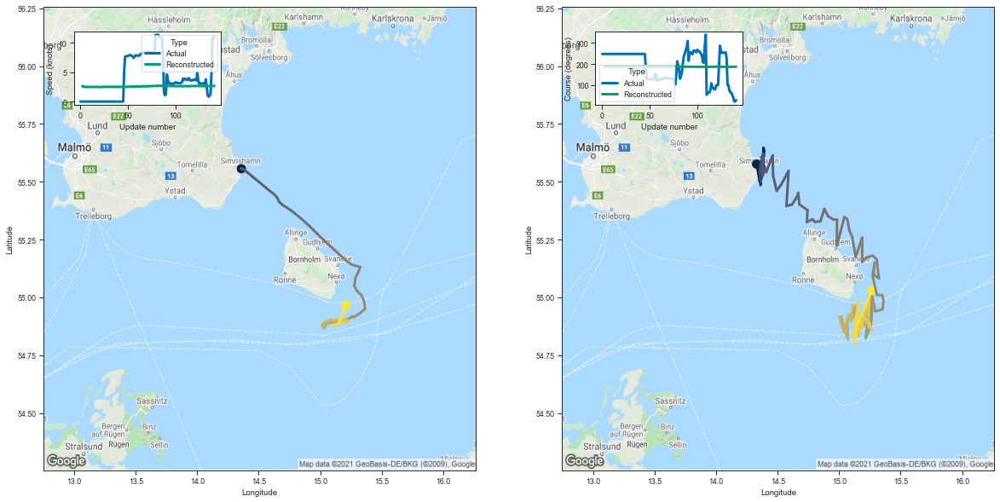

[2.6538302898406982, 2.494130849838257, 2.525797128677368, 2.490403890609741]


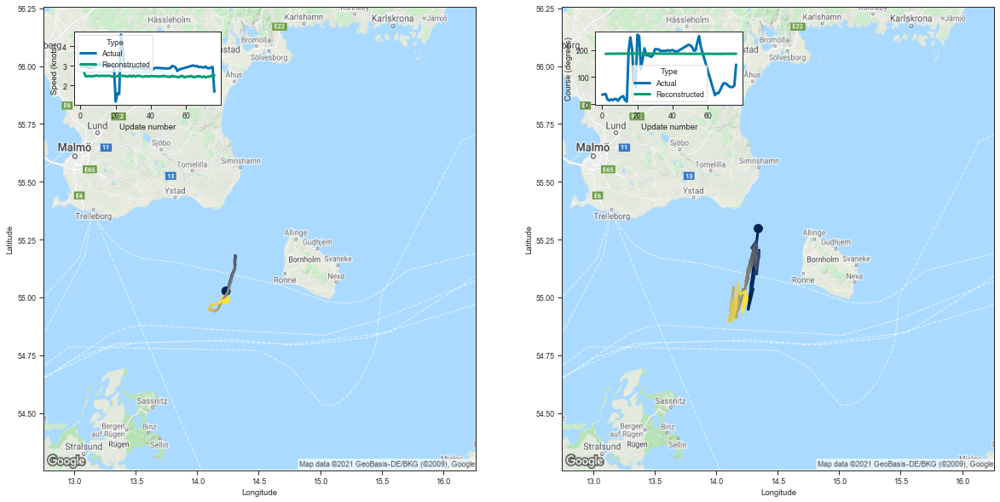

[2.679456949234009, 2.4710190296173096, 2.466996908187866, 2.486887216567993]


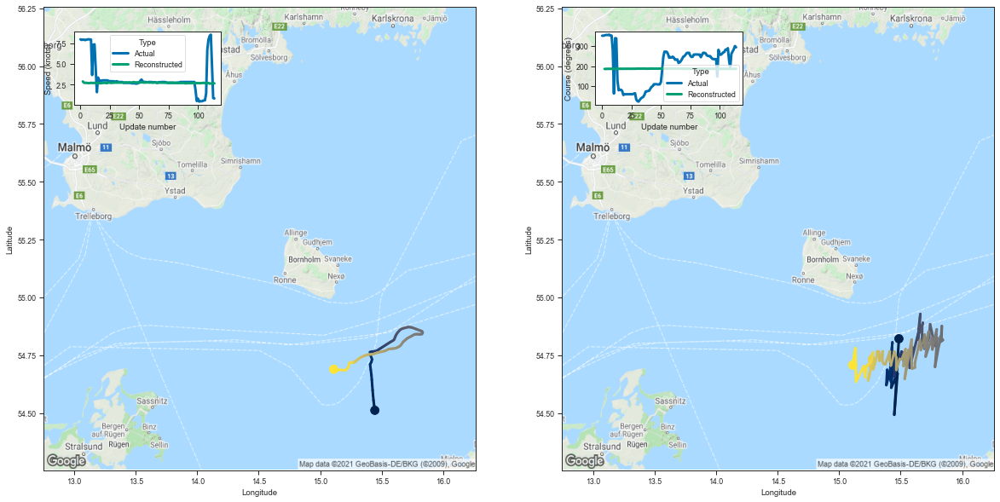

[2.868314027786255, 2.7151029109954834, 2.690880537033081, 2.697826623916626]


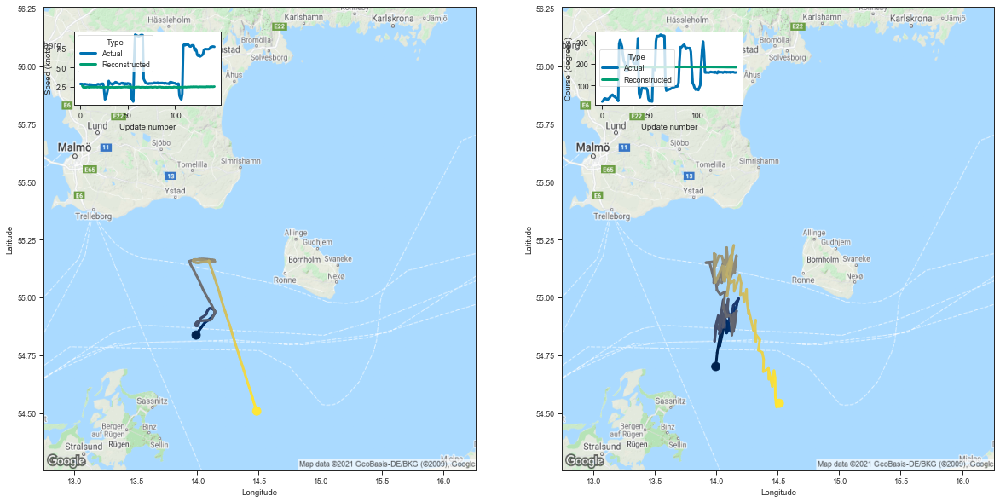

[2.6250460147857666, 2.436821699142456, 2.420910120010376, 2.4179484844207764]


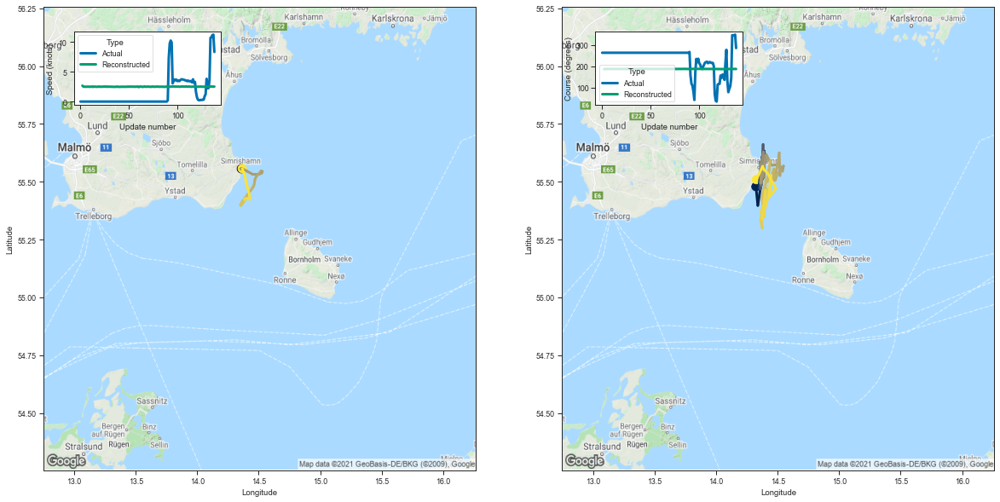

[2.669482469558716, 2.5139405727386475, 2.4950029850006104, 2.4846251010894775]


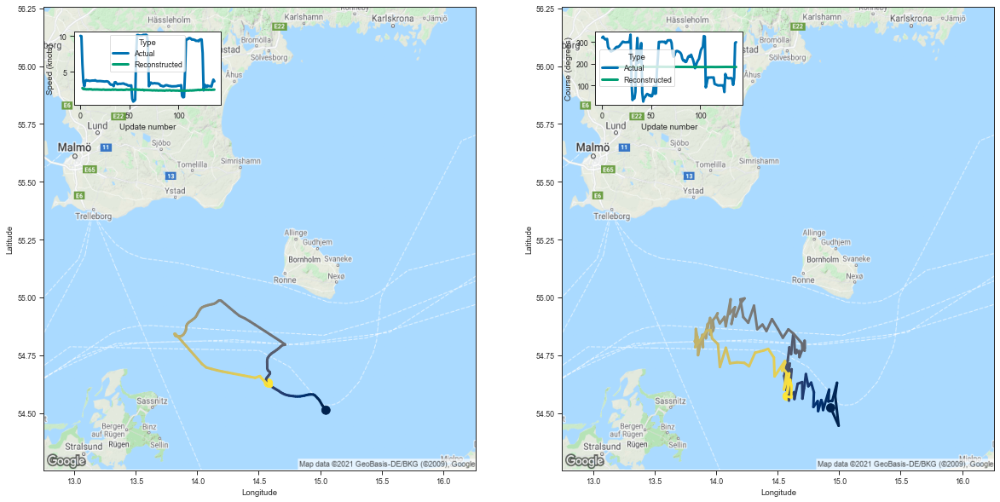

[2.7678439617156982, 2.6299569606781006, 2.6114656925201416, 2.618215799331665]


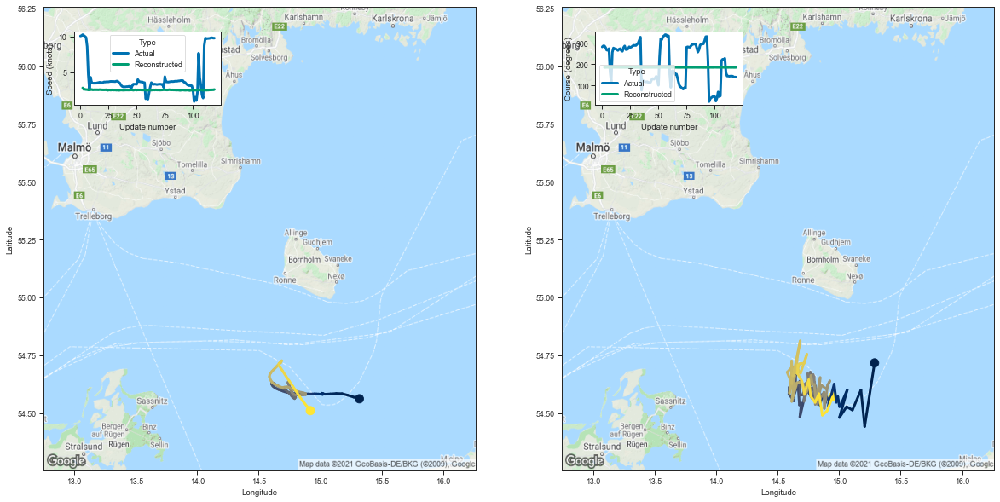

[2.8569533824920654, 2.6413843631744385, 2.6603710651397705, 2.6219027042388916]


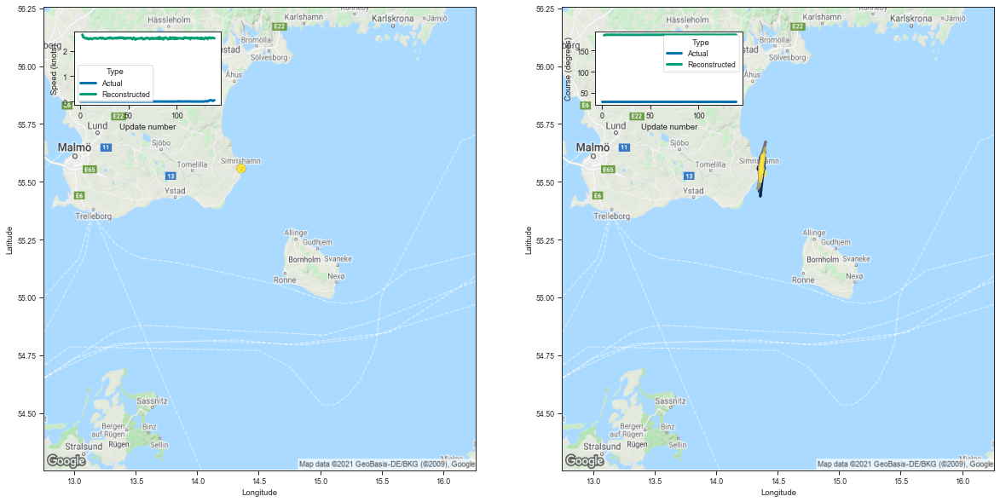

[2.6345789432525635, 2.533923387527466, 2.519606828689575, 2.4944536685943604]


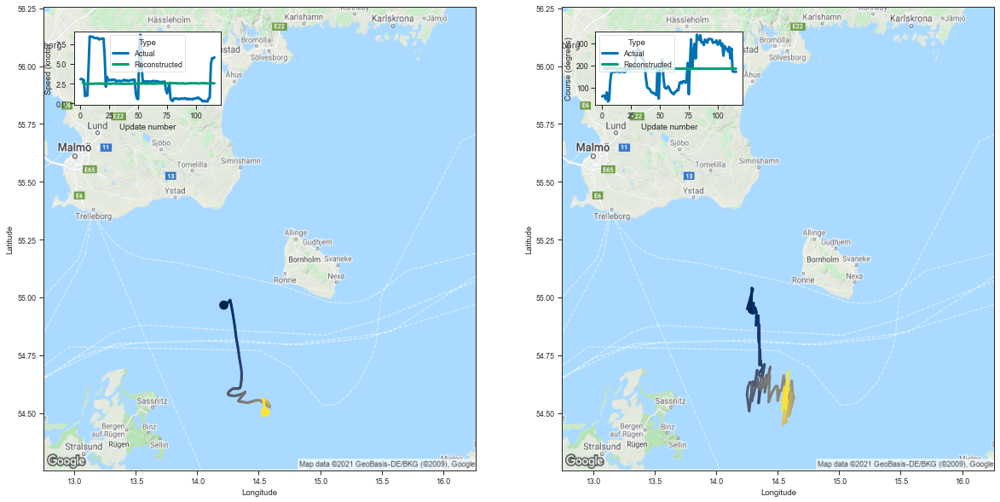

[2.6742289066314697, 2.4774458408355713, 2.4593589305877686, 2.494734525680542]


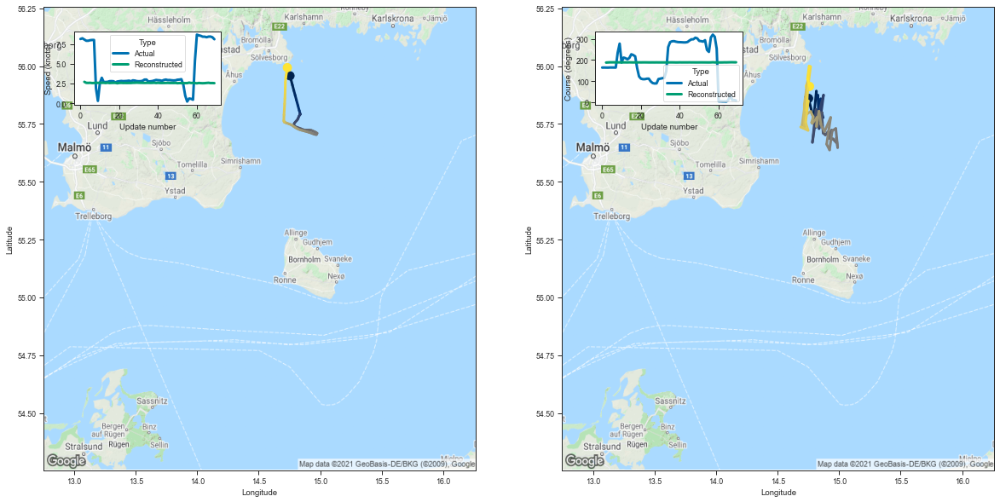

[2.719376802444458, 2.5891668796539307, 2.580237627029419, 2.5949652194976807]


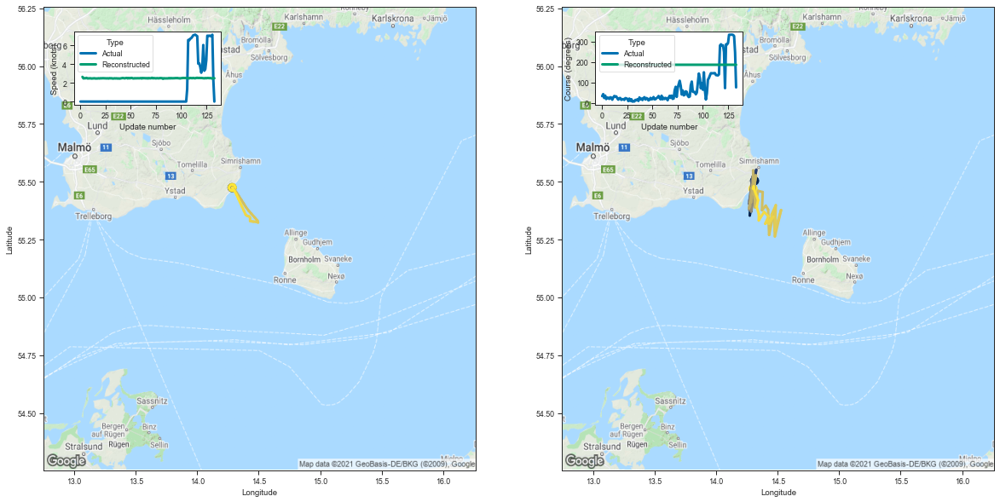

[2.6314680576324463, 2.4678499698638916, 2.48334002494812, 2.4846222400665283]


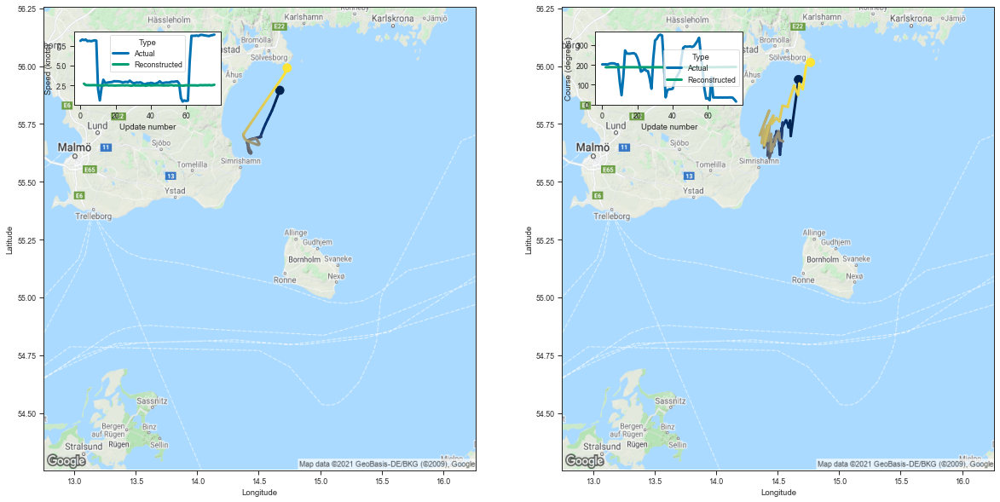

[2.721980333328247, 2.5502912998199463, 2.535127878189087, 2.5326154232025146]


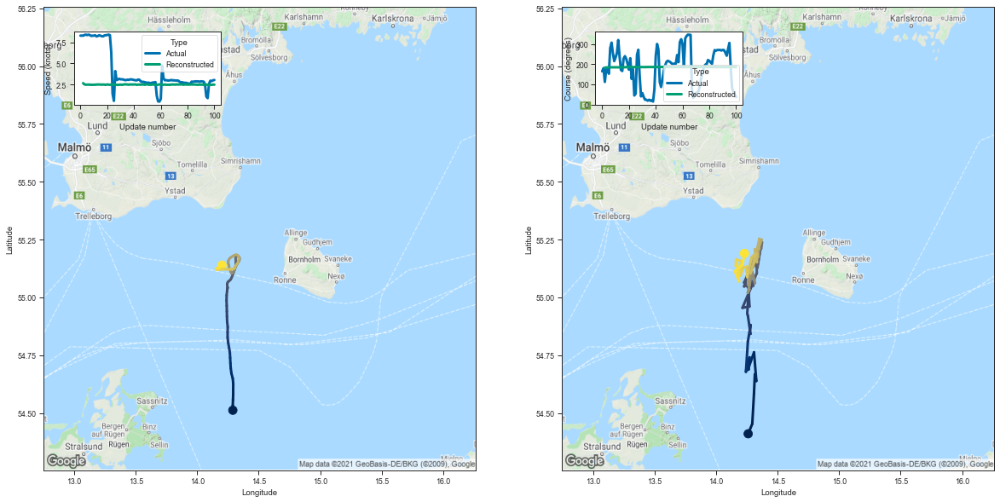

[2.6544439792633057, 2.5089404582977295, 2.4708030223846436, 2.480994462966919]


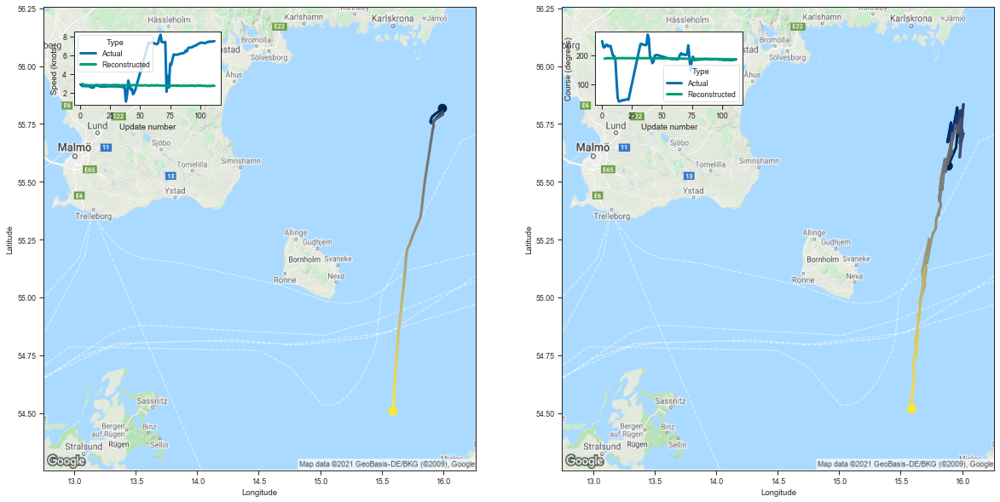

[2.928424119949341, 2.7633512020111084, 2.7925665378570557, 2.7879507541656494]


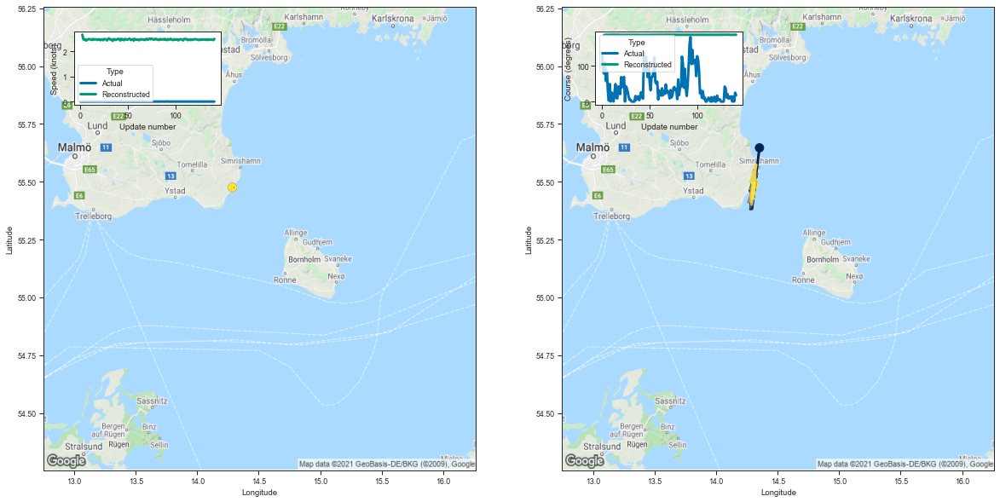

[2.6750576496124268, 2.498314619064331, 2.4674713611602783, 2.485680341720581]


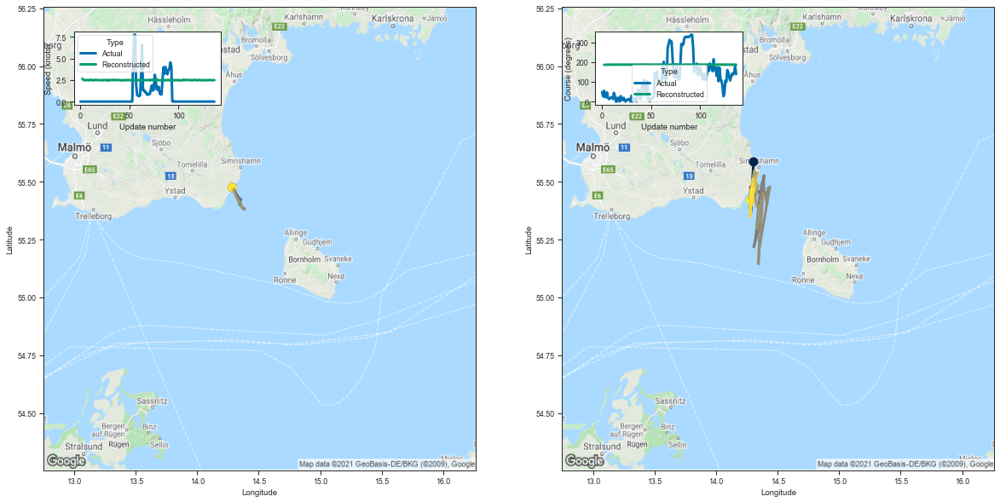

[2.646650552749634, 2.5091259479522705, 2.472743272781372, 2.4861180782318115]


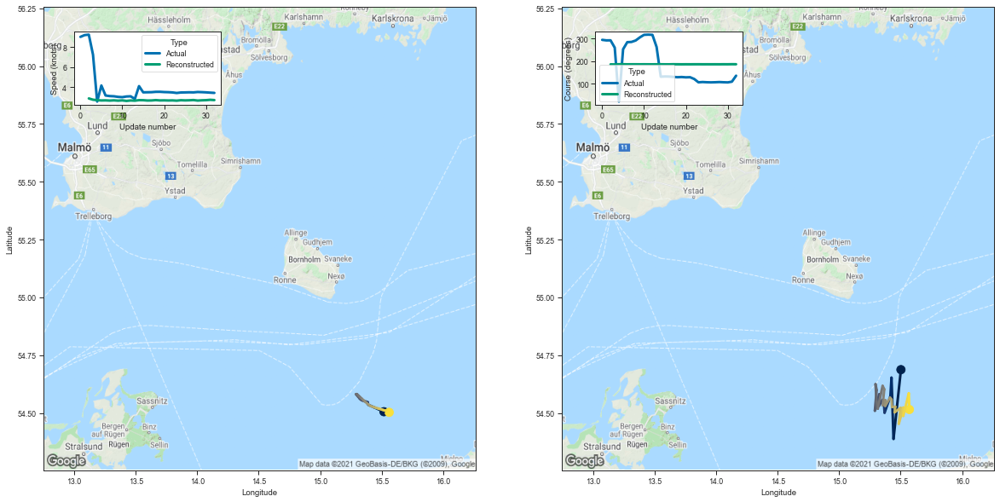

[2.8725297451019287, 2.7452762126922607, 2.6997592449188232, 2.669391393661499]


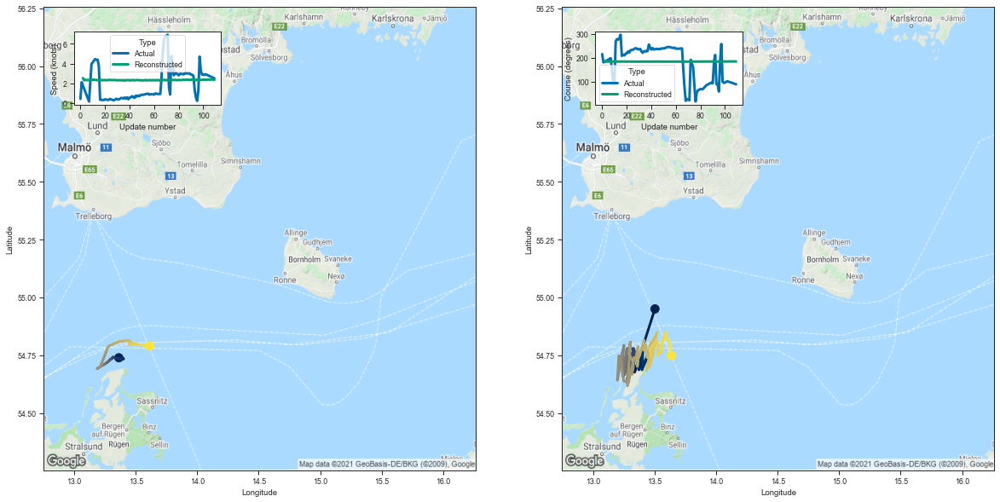

[2.518251657485962, 2.3021323680877686, 2.3482415676116943, 2.3165371417999268]


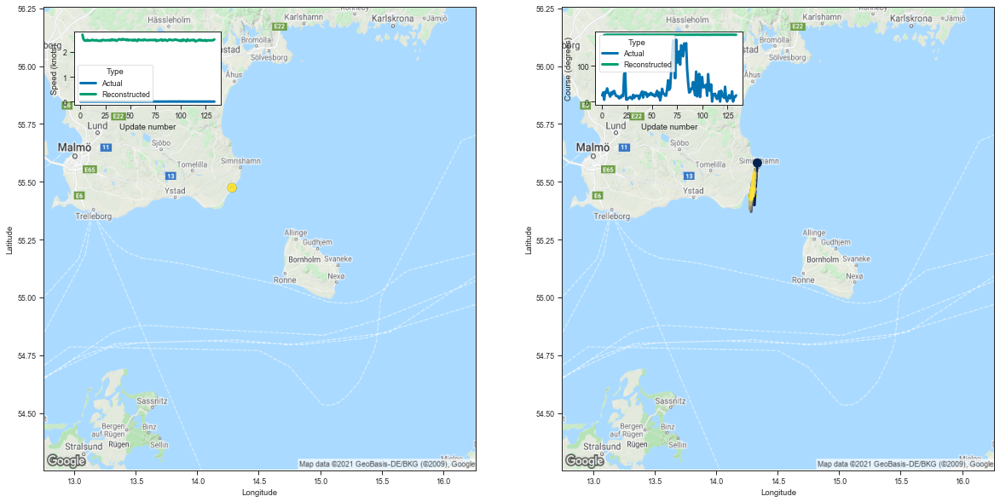

[2.7023017406463623, 2.527081251144409, 2.4684159755706787, 2.4621899127960205]


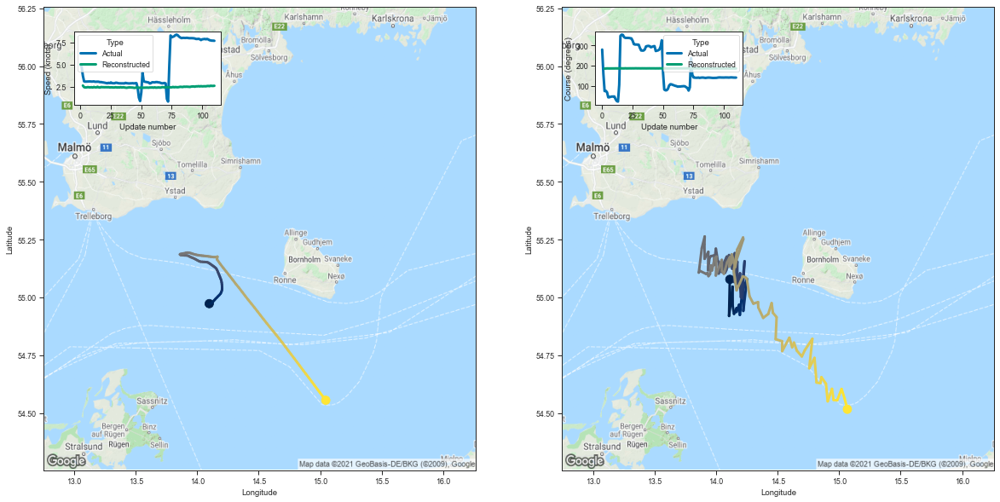

[2.649733781814575, 2.4686038494110107, 2.4355523586273193, 2.443338632583618]


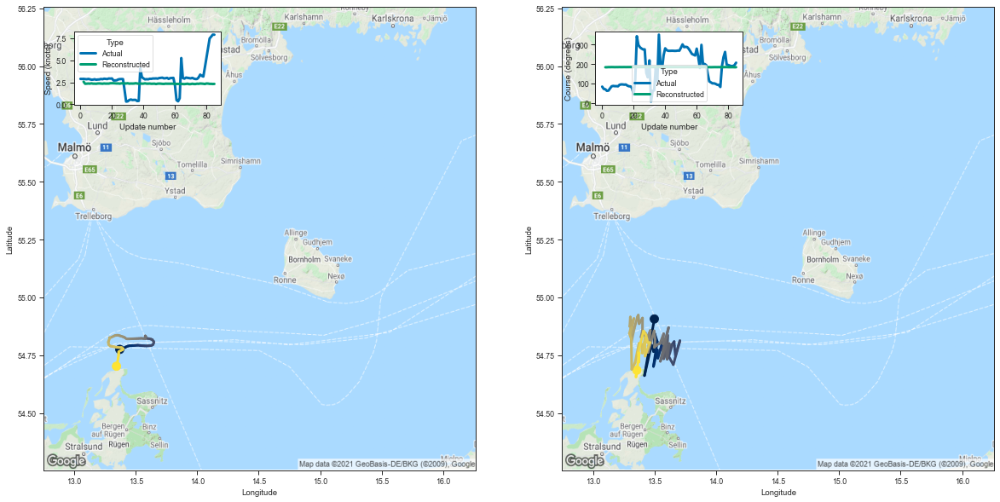

[2.564872980117798, 2.327522039413452, 2.34179425239563, 2.3577539920806885]


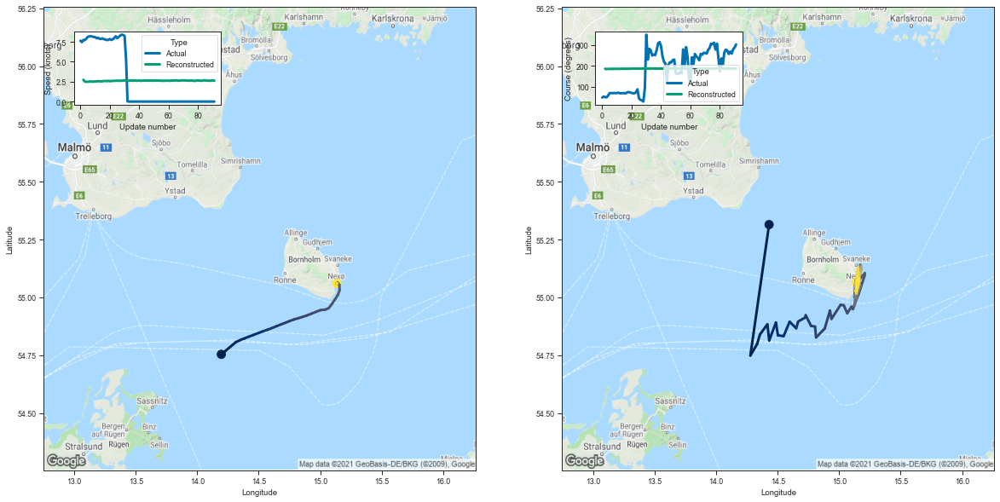

[2.7385313510894775, 2.5103890895843506, 2.482318639755249, 2.491297483444214]


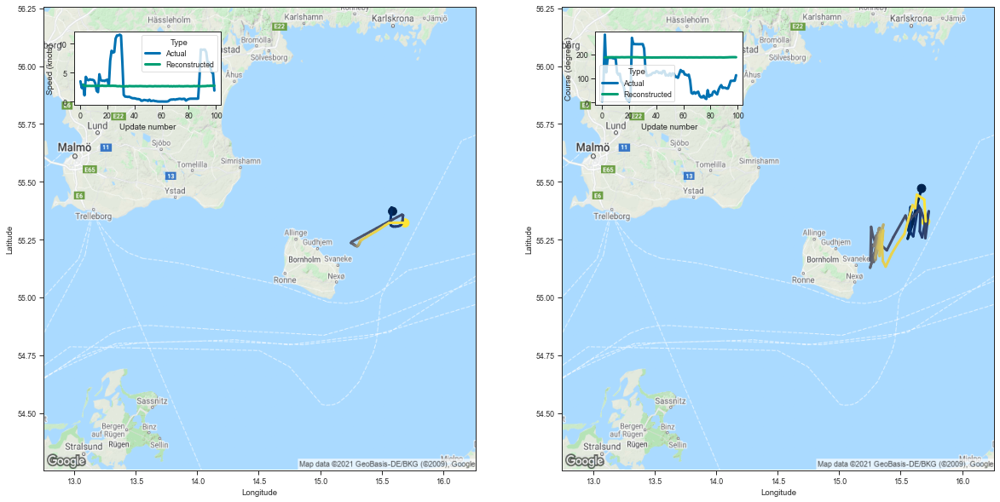

[2.9245765209198, 2.724747896194458, 2.7246997356414795, 2.7096922397613525]


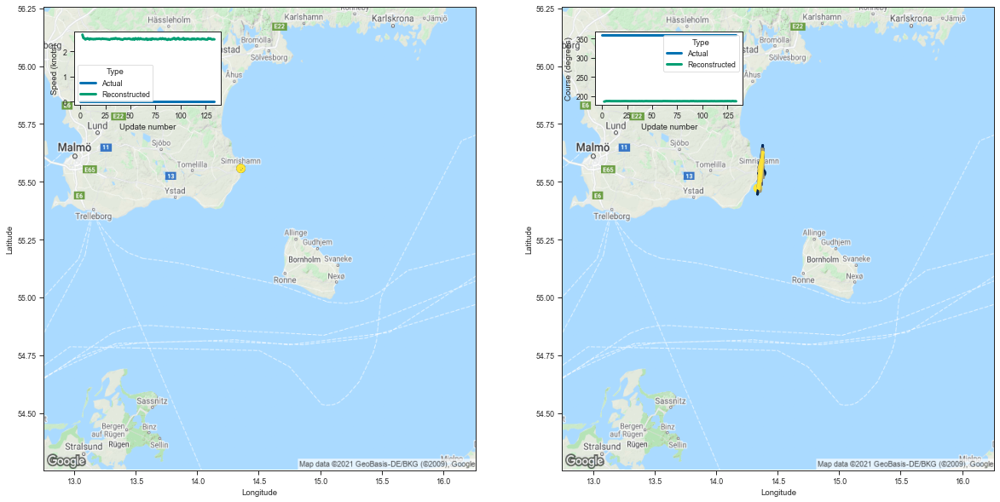

[2.670232057571411, 2.5335776805877686, 2.519371271133423, 2.476273775100708]


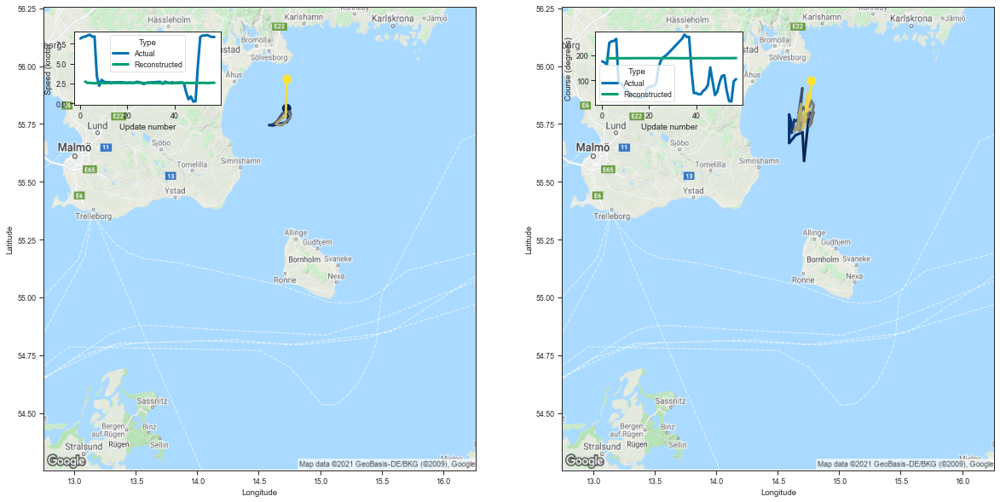

[2.7357070446014404, 2.549034357070923, 2.5672099590301514, 2.5371978282928467]


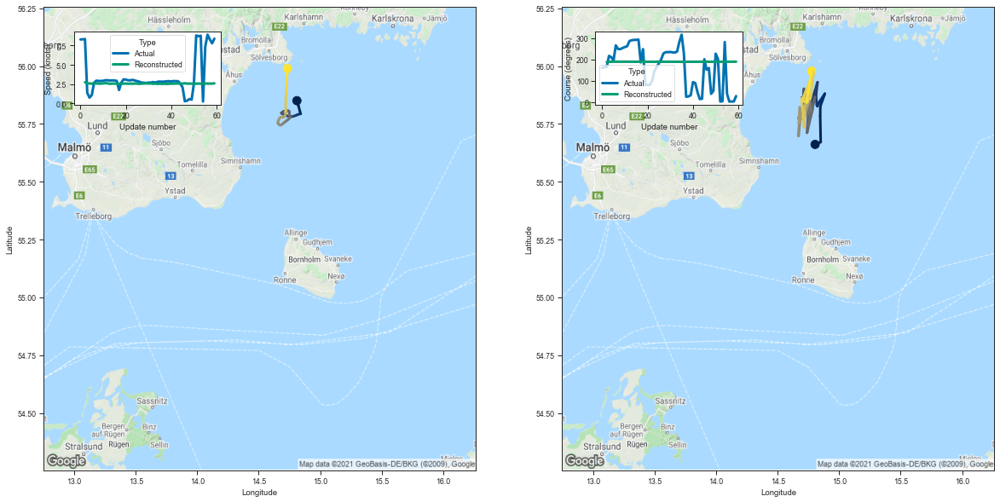

[2.7437174320220947, 2.586226224899292, 2.584782838821411, 2.551513910293579]


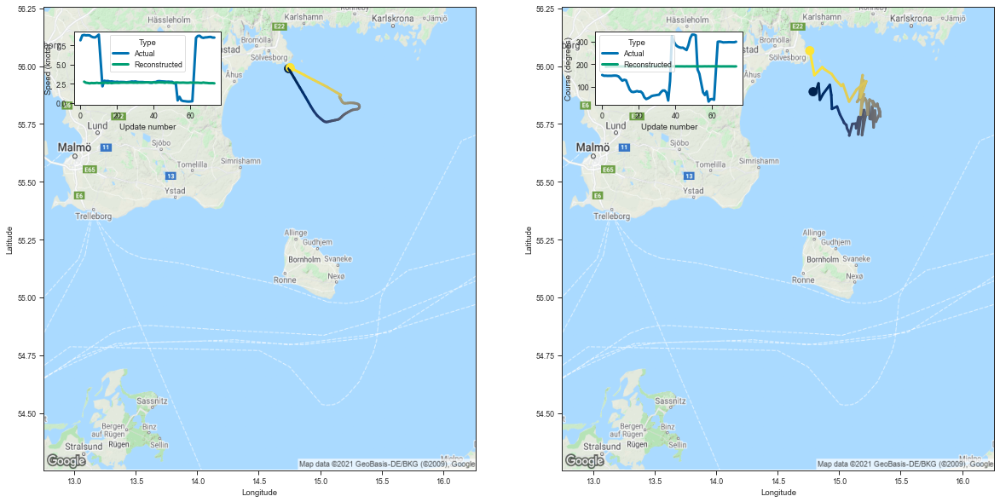

[2.7722065448760986, 2.634838342666626, 2.6013104915618896, 2.5509307384490967]


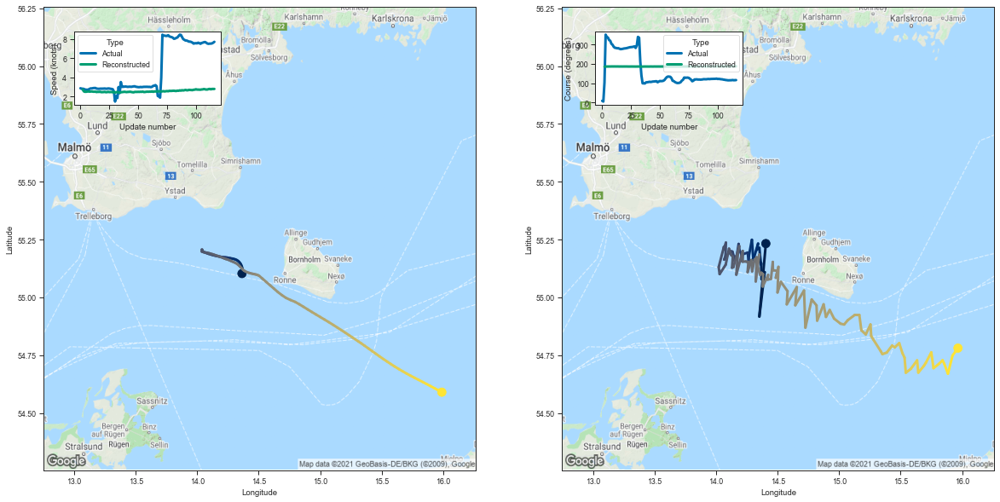

[2.718238592147827, 2.516014814376831, 2.480881929397583, 2.4851315021514893]


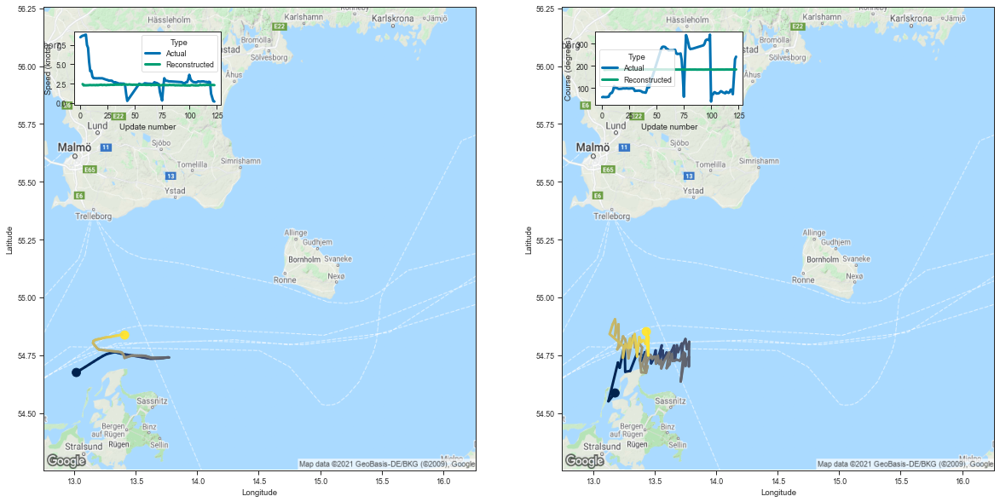

[2.453456163406372, 2.282104730606079, 2.3064119815826416, 2.2892730236053467]


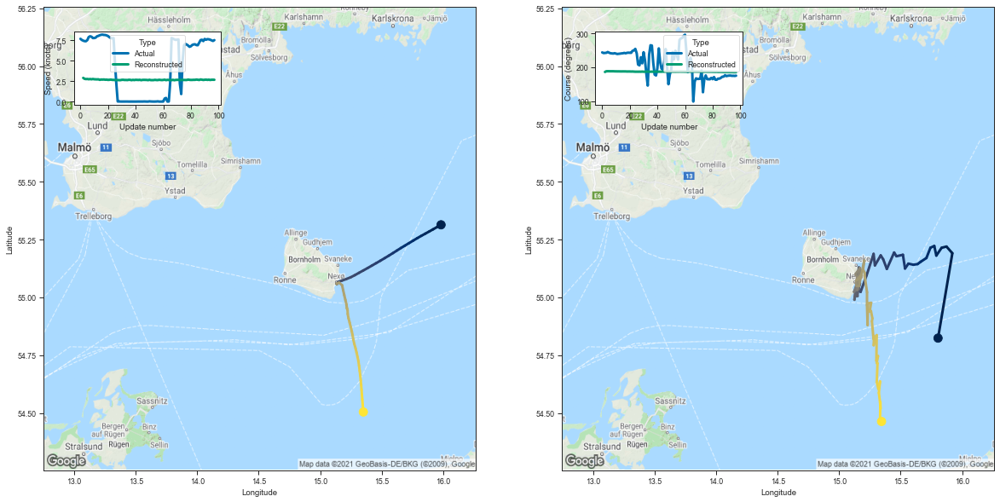

[2.88922381401062, 2.776691198348999, 2.7450082302093506, 2.7587740421295166]


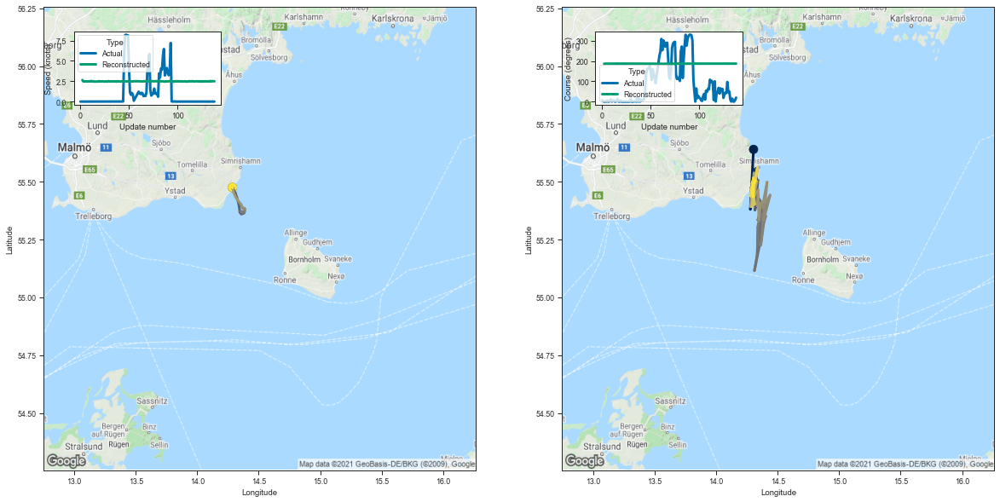

[2.6514270305633545, 2.4760305881500244, 2.4846417903900146, 2.457679033279419]


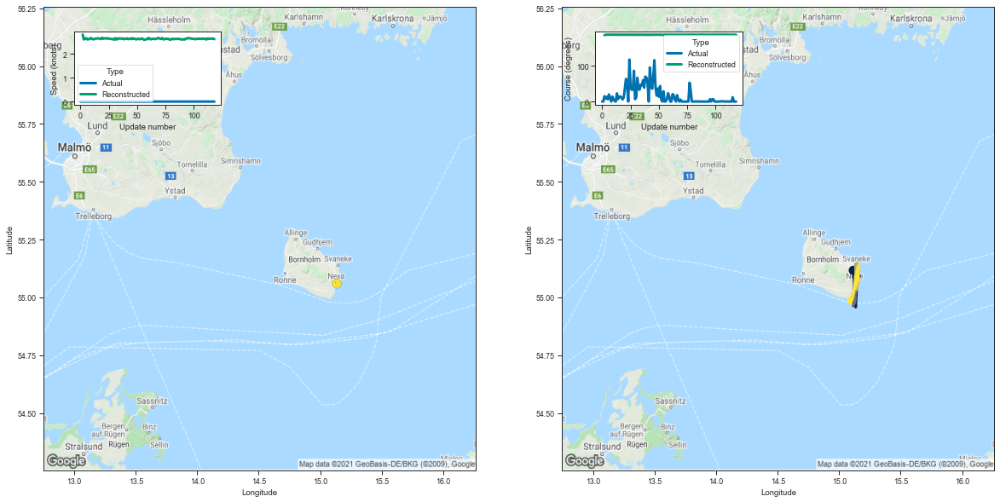

[2.8061411380767822, 2.603070020675659, 2.6410176753997803, 2.6578733921051025]


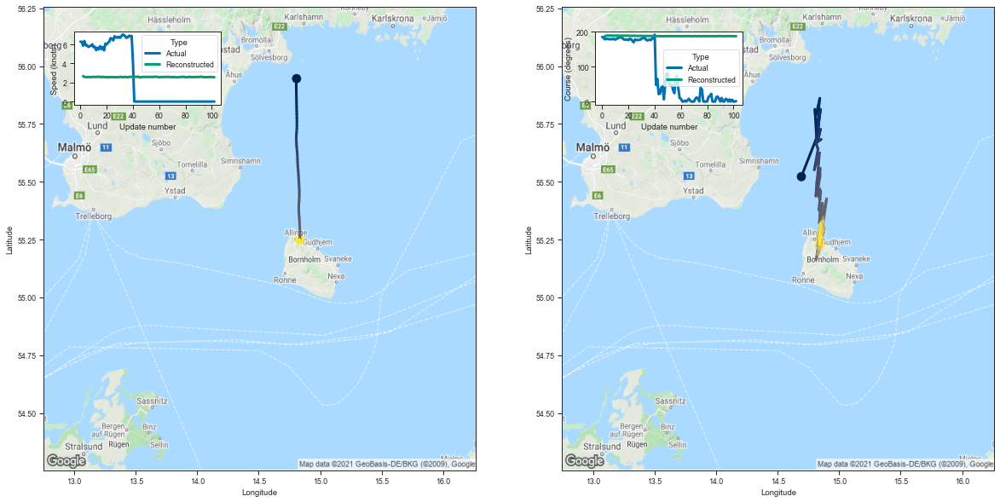

[2.6881492137908936, 2.58139967918396, 2.580188035964966, 2.5604207515716553]


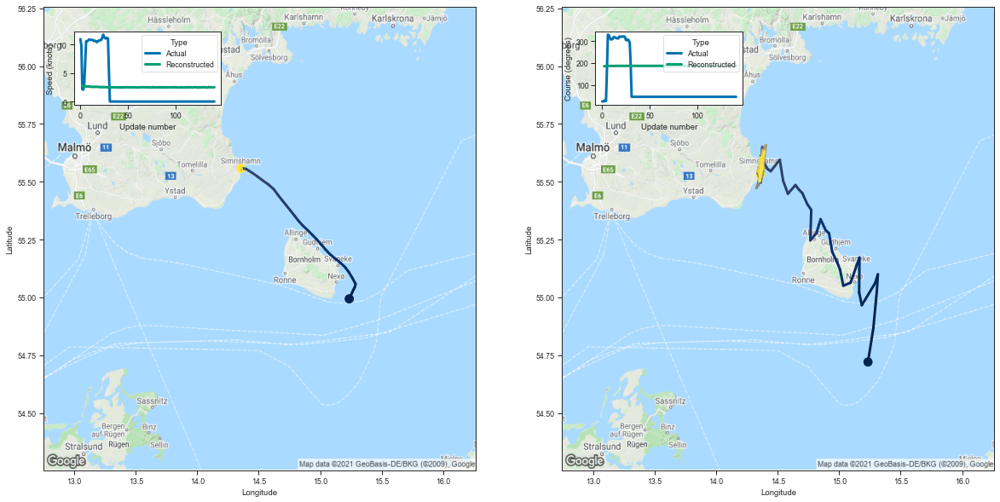

[2.810960054397583, 2.6665871143341064, 2.672285795211792, 2.653996706008911]


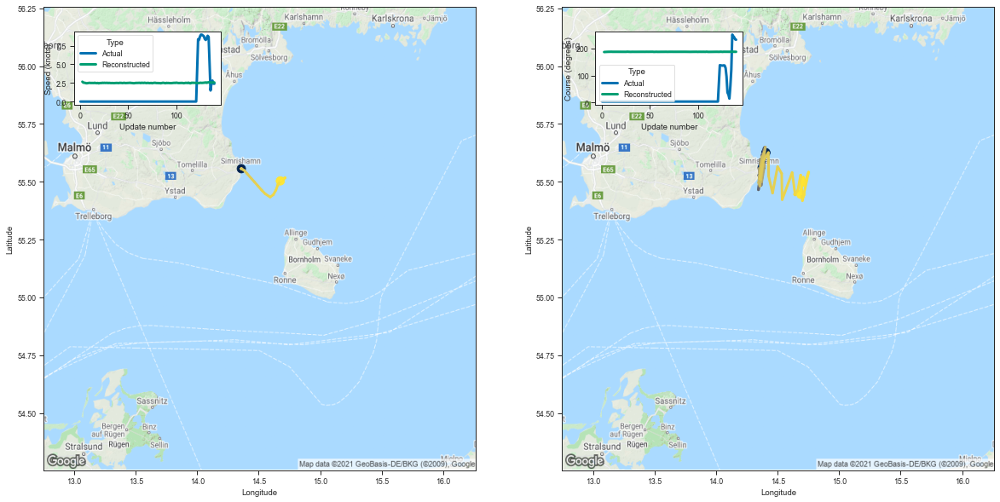

[2.6675145626068115, 2.5461199283599854, 2.525070905685425, 2.5055534839630127]


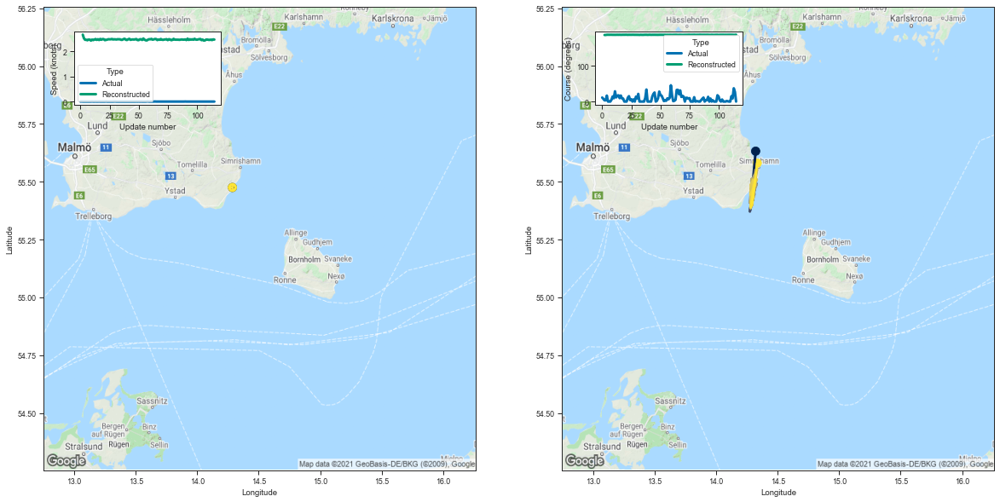

[2.6768696308135986, 2.5315029621124268, 2.47033953666687, 2.469592809677124]


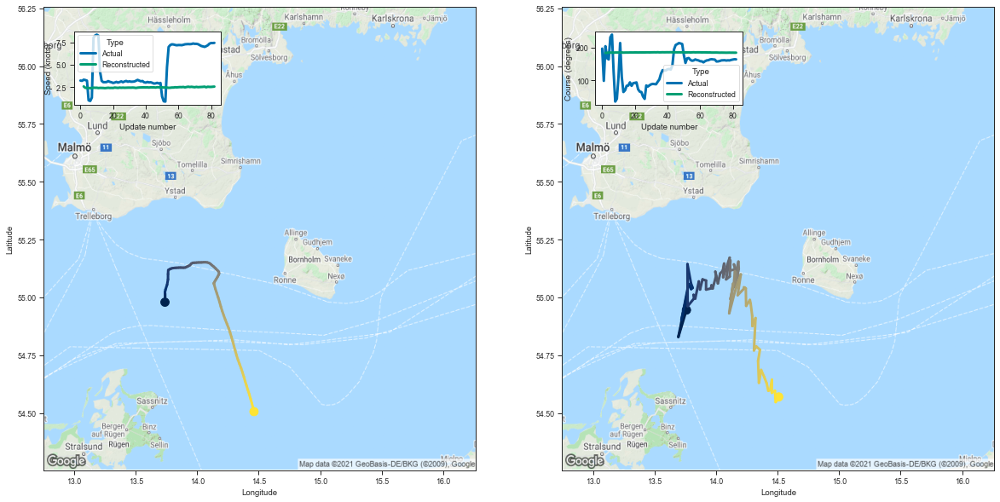

[2.5615665912628174, 2.4101369380950928, 2.3826000690460205, 2.389605760574341]


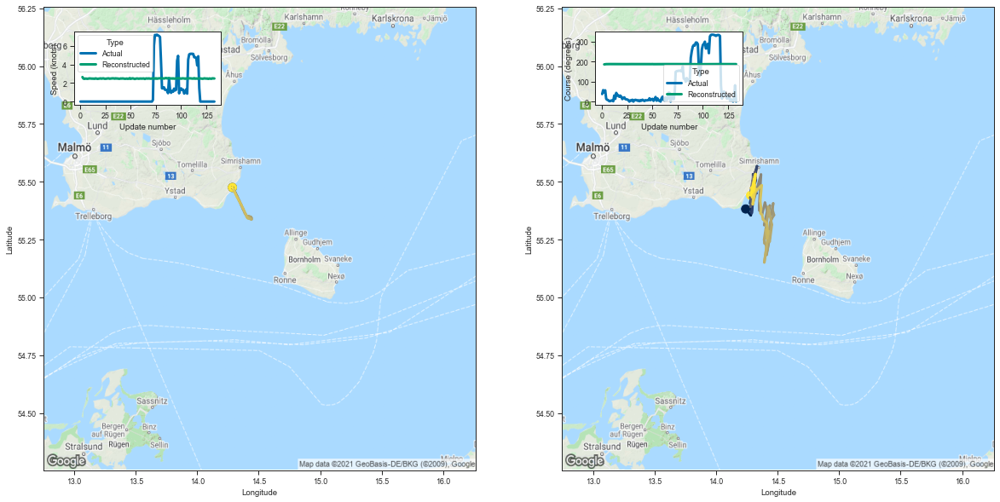

[2.645799398422241, 2.477545976638794, 2.4508602619171143, 2.484135866165161]


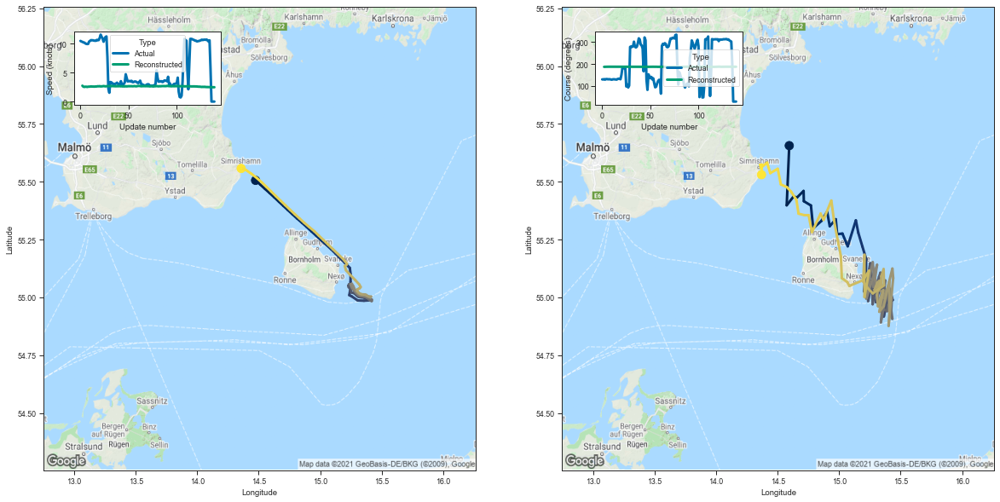

[2.744574785232544, 2.5795700550079346, 2.5300300121307373, 2.569829225540161]


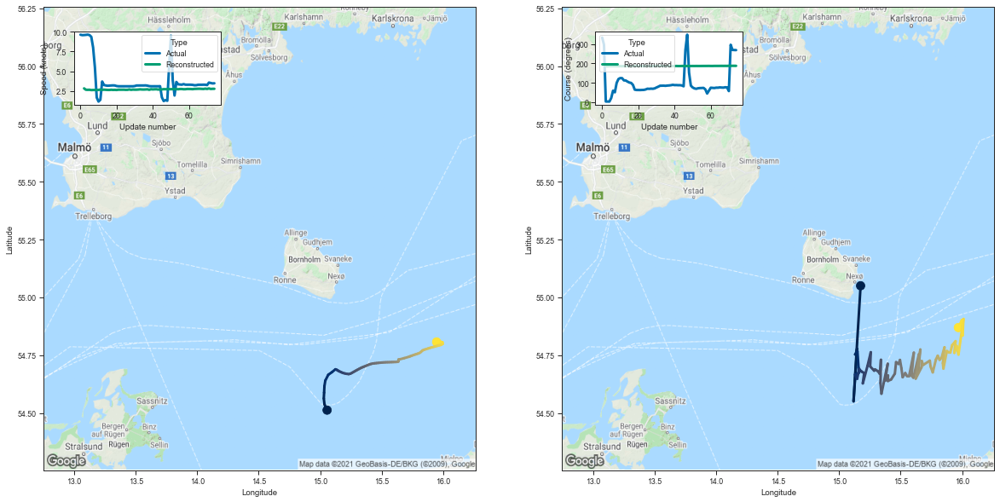

[2.8322360515594482, 2.6615688800811768, 2.6487929821014404, 2.65803599357605]


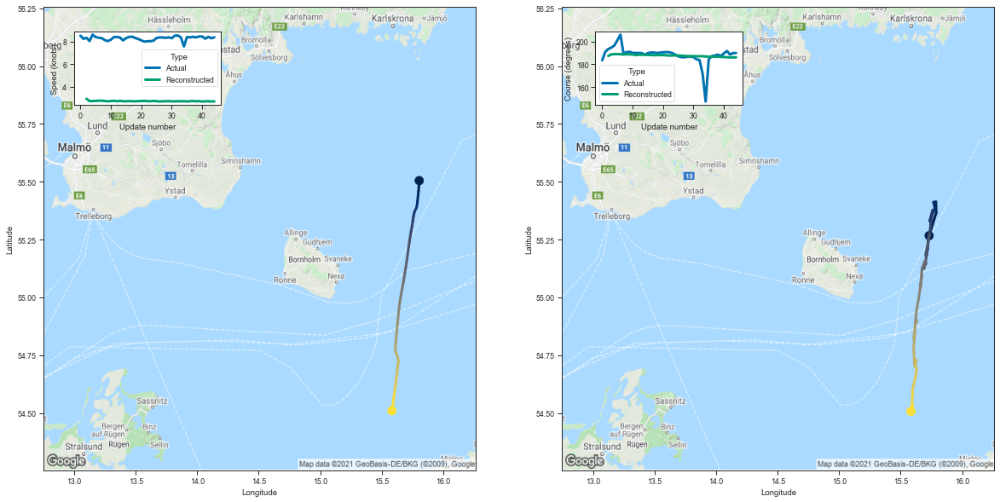

[2.936973810195923, 2.7403581142425537, 2.746772527694702, 2.7557742595672607]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
20,20,1961288,230069190,Fishing,134,-471.895081,-3.521605
98,98,2159262,230069190,Fishing,141,-505.131378,-3.582492
60,60,6869996,265759000,Fishing,143,-513.452942,-3.590580
17,17,6685896,265759000,Fishing,143,-515.683716,-3.606180
4,4,2259131,230069190,Fishing,141,-509.631927,-3.614411
...,...,...,...,...,...,...,...
7,7,3067071,261002520,Fishing,83,-443.694458,-5.345716
104,104,5025657,265681420,Fishing,134,-727.007202,-5.425427
91,91,5598936,265750000,Fishing,140,-762.813416,-5.448667
112,112,3451602,261003230,Fishing,75,-409.272766,-5.456970


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n